### Data Challenge

<b>Mohamed SANAD</b>

For this data challenge, we will work on histopathological images. The dataset consists of microscopic images of breast tumor tissue collected from several patients. These images have the following properties: 700x460 pixels, 3-channel RGB, 8-bit depth in each channel, PNG format.

We have two subfolders :

● <b>Train :</b> contains a set of training images with labels.
<br>● <b>Test :</b> contains a set of images with no available labels.

These images correspond to samples of breast tumors that are either benign or malignant. Among malginants, we can also distinguish between different types of tumors. For this data challenge, we will be evaluated on the prediction of the type of tumors (8 possible classes).

The chosen metric for this evalaution is the F1-Score (weighted average).

### Import packages :

In [1]:
import numpy as np
import pandas as pd
import cv2
import mahotas
import os
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.axes_grid1 import ImageGrid
from skimage import io
from skimage.feature import local_binary_pattern, hog
from skimage.transform import resize
from tabulate import tabulate
import random
import joblib
from collections import Counter
from imblearn.over_sampling import SMOTE, ADASYN
from imblearn.combine import SMOTETomek, SMOTEENN

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV, StratifiedKFold

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import xgboost

from sklearn.metrics import accuracy_score, classification_report, f1_score
from sklearn.metrics import ConfusionMatrixDisplay

In [153]:
import warnings
warnings.filterwarnings('ignore', message="DeprecationWarning: ")
warnings.filterwarnings('ignore', message="ConvergenceWarning: ")
warnings.filterwarnings('ignore', message="UserWarning: ")

In [157]:
conf = plt.rcParams

conf['figure.max_open_warning'] = 0

### Data visualisation :

In [3]:
# get the train set images list from folder
train_images = os.listdir(path='data-challenge/Train/')

# get the test set images list from folder
test_images = os.listdir(path='data-challenge/Test/')

# Number of images
print("Number of images in the train set : ", len(train_images))
print("Number of images in the test set : ", len(test_images))

Number of images in the train set :  422
Number of images in the test set :  207


<function skimage.io._io.show()>

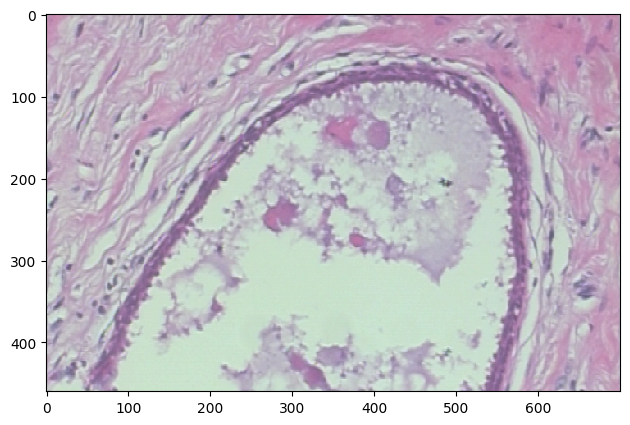

In [4]:
# Image visualisation (Train)
io.imshow('data-challenge/Train/' + train_images[0])
io.show

<function skimage.io._io.show()>

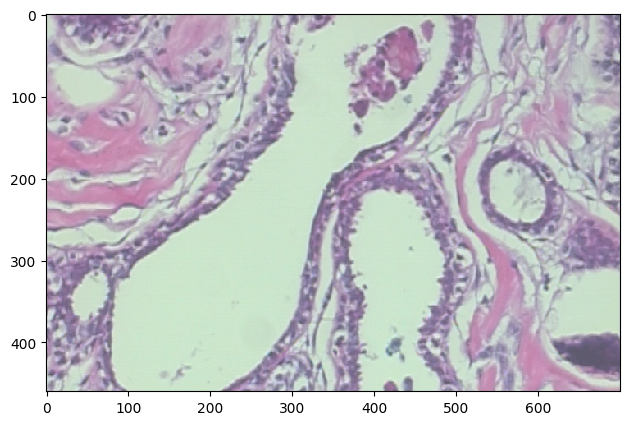

In [5]:
# Image visualisation (Test)
io.imshow('data-challenge/Test/' + test_images[0])
io.show

### Dataset building :

All the informations about the images are contained in the filename of each image. For example, we take the first image in the train set and print its filename :

In [6]:
train_images[0]

'SOB_B_A-14-22549AB-100-001.png'

● <b>procedure :</b> SOB
<br>● <b>class :</b> B
<br>● <b>type :</b> A
<br>● <b>magnification :</b> 14
<br>● <b>slide :</b> 22549AB
<br>● <b>mag :</b> 100
<br>● <b>seq :</b> 001

<b>B</b> stands for <i>"Benign"</i> and <b>M</b> stands for <i>"Malignant"</i>.

In [7]:
def parse_fn(filename):
    # <BIOPSY_PROCEDURE>_<TUMOR_CLASS>_<TUMOR_TYPE>-<YEAR>-<SLIDE_ID>-<MAG>-<SEQ>
    parsed = filename[:-4].replace('-', '_').split('_')
    parsed.append(filename)
    return parsed

columns = ['procedure', 'class', 'type', 'magnification', 'slide', 'mag', 'seq', 'filename']

df = pd.DataFrame(list(map(parse_fn, train_images)), columns=columns)
label_types = df['type'].unique()
print("Tumor types : ", label_types)

Tumor types :  ['A' 'F' 'PT' 'TA' 'DC' 'LC' 'MC' 'PC']


In [8]:
df.head()

,procedure,class,type,magnification,slide,mag,seq,filename
0,SOB,B,A,14,22549AB,100,001,SOB_B_A-14-22549AB-100-001.png
1,SOB,B,A,14,22549AB,100,002,SOB_B_A-14-22549AB-100-002.png
2,SOB,B,A,14,22549AB,100,003,SOB_B_A-14-22549AB-100-003.png
3,SOB,B,A,14,22549AB,100,005,SOB_B_A-14-22549AB-100-005.png
4,SOB,B,A,14,22549AB,100,006,SOB_B_A-14-22549AB-100-006.png


<i>Encoding MUST be done with the following correspondance :</i>

F➜1&emsp;DC➜2&emsp;PC➜3&emsp;PT➜4&emsp;MC➜5&emsp;LC➜6&emsp;A➜7&emsp;TA➜8

In [9]:
label_maps = {'F':'1', 'DC':'2', 'PC':'3', 'PT':'4', 'MC':'5', 'LC':'6', 'A':'7', 'TA':'8'}
df['type_id'] = df['type'].apply(lambda x: label_maps[x])

df.head()

,procedure,class,type,magnification,slide,mag,seq,filename,type_id
0,SOB,B,A,14,22549AB,100,001,SOB_B_A-14-22549AB-100-001.png,7
1,SOB,B,A,14,22549AB,100,002,SOB_B_A-14-22549AB-100-002.png,7
2,SOB,B,A,14,22549AB,100,003,SOB_B_A-14-22549AB-100-003.png,7
3,SOB,B,A,14,22549AB,100,005,SOB_B_A-14-22549AB-100-005.png,7
4,SOB,B,A,14,22549AB,100,006,SOB_B_A-14-22549AB-100-006.png,7


In [10]:
print("Number of images with a beningn breast tumor : ", len(df.loc[df['class']=='B']))
print("Number of images with a malignant breast tumor : ", len(df.loc[df['class']=='M']))

Number of images with a beningn breast tumor :  210
Number of images with a malignant breast tumor :  212


<AxesSubplot: xlabel='type', ylabel='Count'>

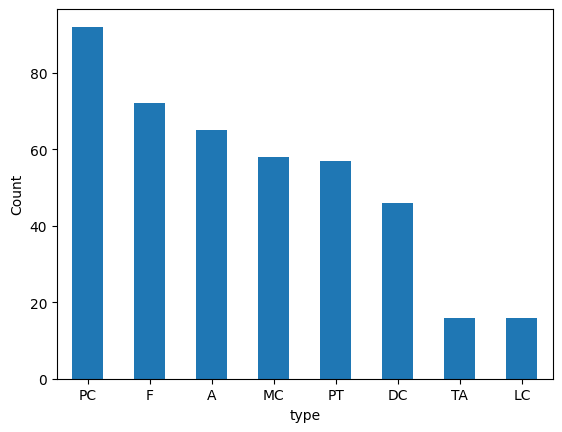

In [11]:
df['type'].value_counts().plot(kind='bar', xlabel = 'type', ylabel='Count', rot=0)

In [12]:
print("Types among benign tumors : ", list(df.loc[df['class']=='B', 'type'].unique()))
print("Types among malignant tumors : ", list(df.loc[df['class']=='M', 'type'].unique()))

Types among benign tumors :  ['A', 'F', 'PT', 'TA']
Types among malignant tumors :  ['DC', 'LC', 'MC', 'PC']


In [13]:
df_types = pd.DataFrame(data={"type":df['type'].value_counts().index,
                              "count":df['type'].value_counts().values,
                              "class":['M','B','B','M','B','M','B','M']})

fig = px.bar(df_types, x="type", y="count", color="class")

fig.update_layout(margin={"t": 5, "b": 5, "l": 0, "r": 0})

fig.show()

We can say that the classes are imbalanced.

### Advanced visualisations :

Here, we visualise the 4 first images of each class :

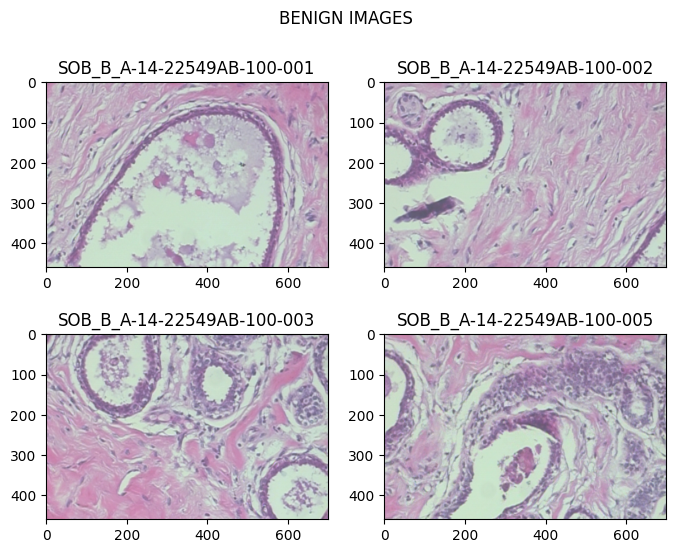

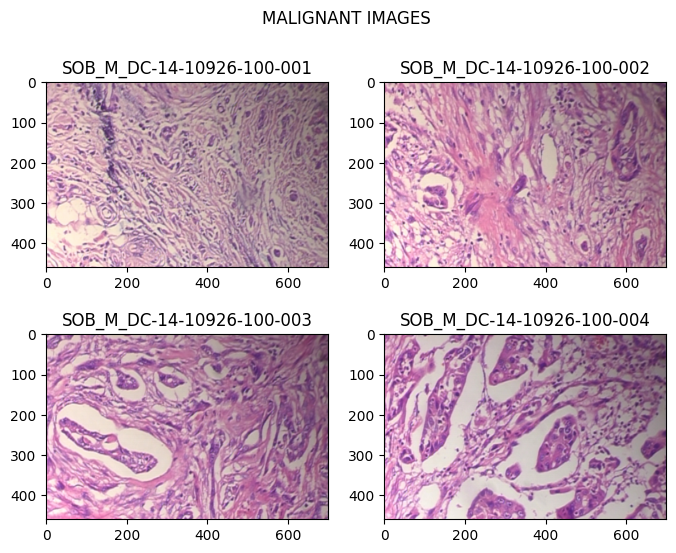

In [14]:
# plot 4 images for each class
b_img = df[df['class'] == 'B'].head(4)
m_img = df[df['class'] == 'M'].head(4)

for class_name, class_images in [['BENIGN', b_img], ['MALIGNANT', m_img]]:
    fig, axs = plt.subplots(2,2,figsize=(8, 6))
    fig.suptitle('{0} IMAGES'.format(class_name), fontsize=12)
    i = 0
    j = 0
    for idx, img in class_images.iterrows():
        ax = axs[i, j]
        ax.set_title(img['filename'][:-4])
        ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
        j = j + 1 if j < 1 else 0
        i = i + 1 if j == 0 else i

Now, we visualise the first image of each type :

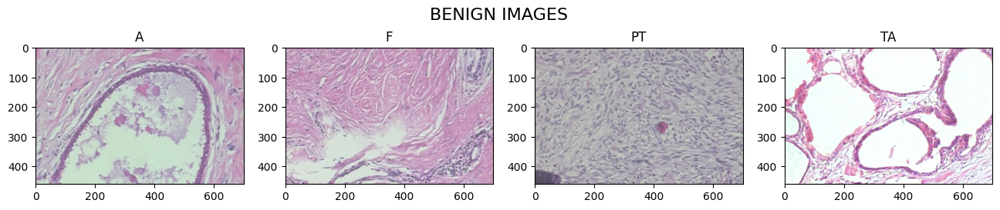

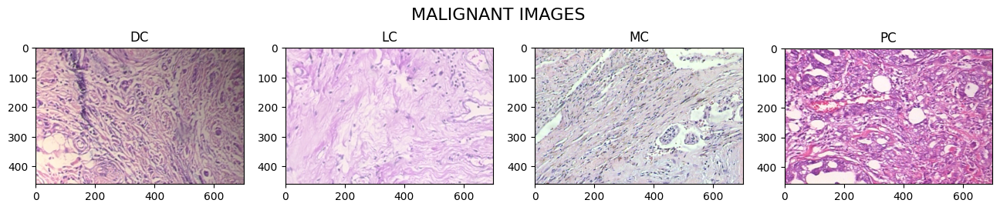

In [15]:
df_img = df.groupby('type').first().reset_index()[['type','filename']]
df_b_img = df_img.loc[df_img['type'].isin(df.loc[df['class']=='B', 'type'].unique())].reset_index(drop=True)
df_m_img = df_img.loc[df_img['type'].isin(df.loc[df['class']=='M', 'type'].unique())].reset_index(drop=True)

fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('BENIGN IMAGES', fontsize=16, y=0.73)
for idx, img in df_b_img.iterrows():
    ax = axs[idx]
    ax.set_title(img['type'])
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('MALIGNANT IMAGES', fontsize=16, y=0.73)
for idx, img in df_m_img.iterrows():
    ax = axs[idx]
    ax.set_title(img['type'])
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))

For each type, we will sample 4 random images in order to visualize the characteristics of each type :

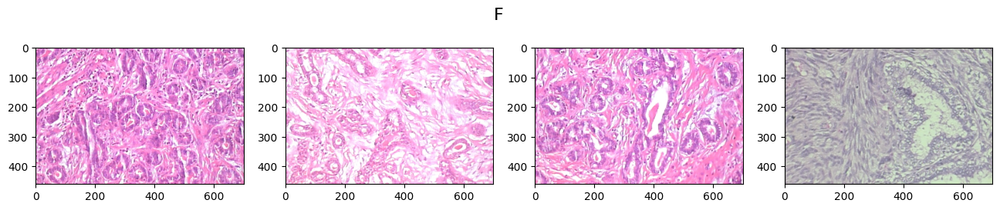

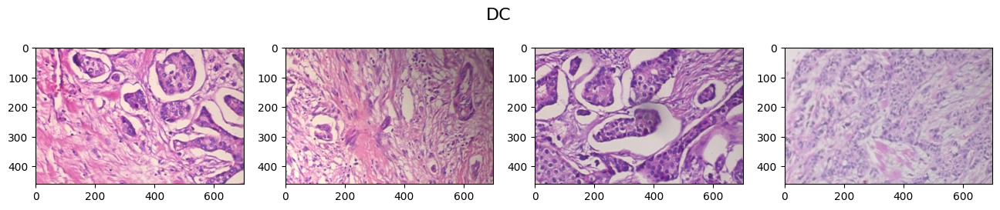

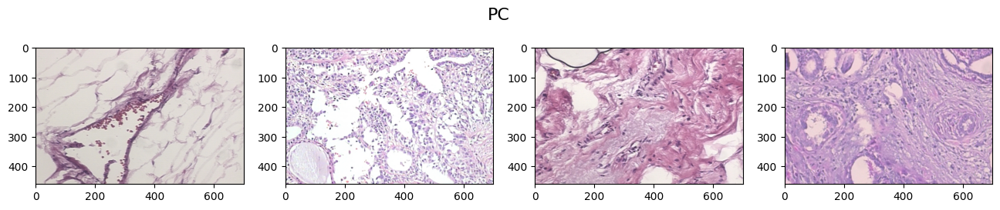

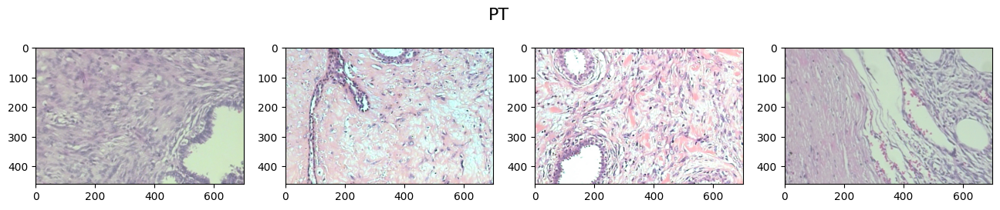

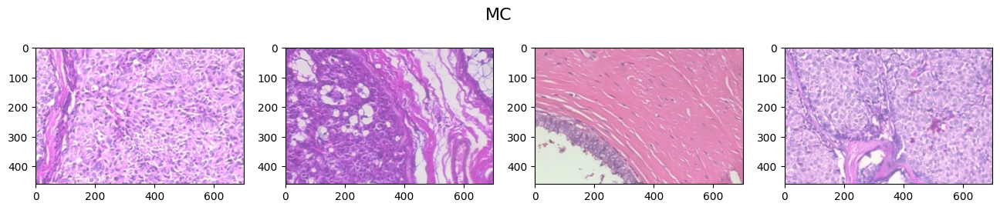

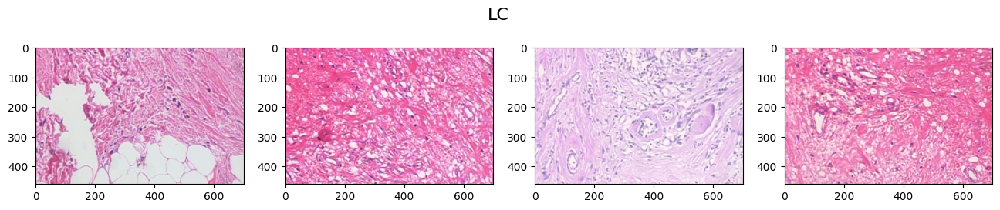

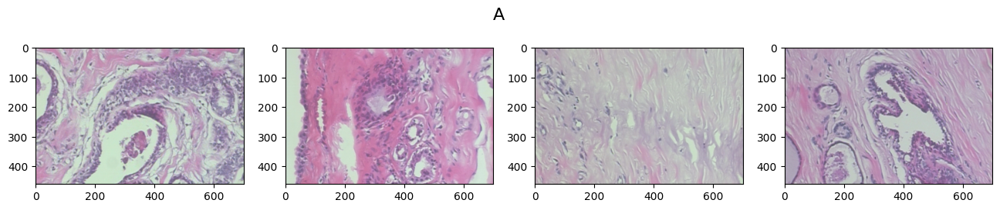

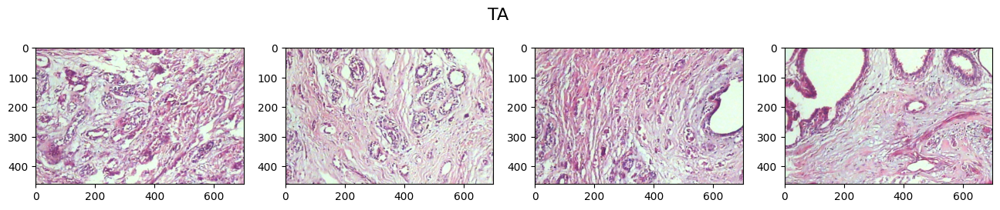

In [16]:
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('F', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='F'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('DC', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='DC'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('PC', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='PC'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('PT', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='PT'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('MC', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='MC'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('LC', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='LC'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('A', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='A'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1
    
fig, axs = plt.subplots(1, 4, figsize=(16, 6))
fig.suptitle('TA', fontsize=16, y=0.73)
i=0
for idx, img in df.iloc[random.sample(list(df.loc[df['type']=='TA'].index), 4), :].iterrows():
    ax = axs[i]
    ax.imshow(io.imread('data-challenge/Train/' + img['filename']))
    i+=1

### Features extraction :

● To perform machine learning, we need to map each image to a vector or representation.

● Feature extraction is necessary to extract information from the raw data, in order to enrich their description. Selecting the most meaningful features is a crucial step in the process of classification problems.

● The selected set of features should be a small set whose values efficiently discriminate among patterns of the different classes, but are similar for patterns within the same class.

The images have the following properties : 700x460 pixels, 3-channel RGB, 8-bit depth in each channel (which means that the values go from 0 to 255)

In [17]:
img = io.imread('data-challenge/Train/'+ train_images[0])
print("Shape of an image : ", img.shape)

Shape of an image :  (460, 700, 3)


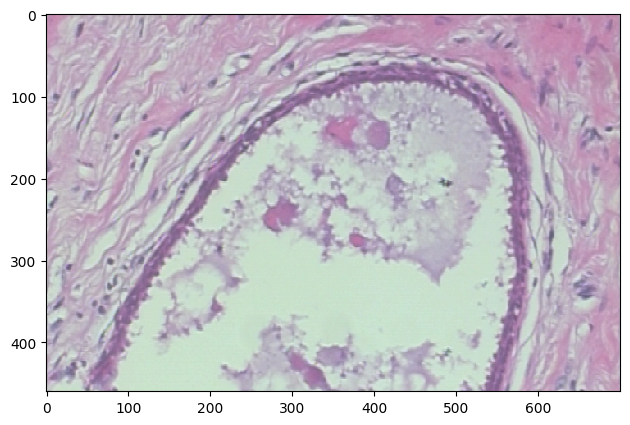

In [18]:
### Plot the image
io.imshow(img)

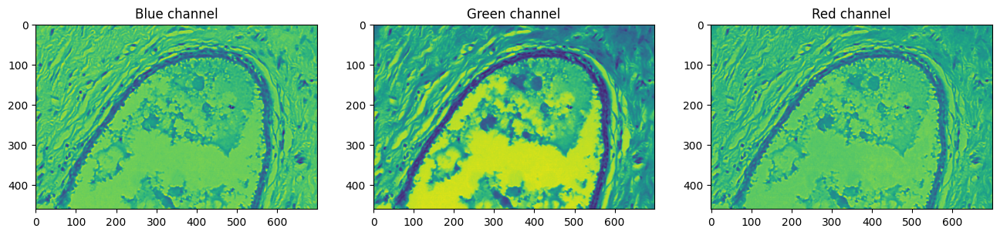

In [19]:
### Plot the BGR channels
B = img[:,:,0]
G = img[:,:,1]
R= img[:,:,2]

fig, axs = plt.subplots(1, 3, figsize=(16, 6))

ax = axs[0]
ax.set_title('Blue channel')
ax.imshow(B)

ax = axs[1]
ax.set_title('Green channel')
ax.imshow(G)

ax = axs[2]
ax.set_title('Red channel')
ax.imshow(R)

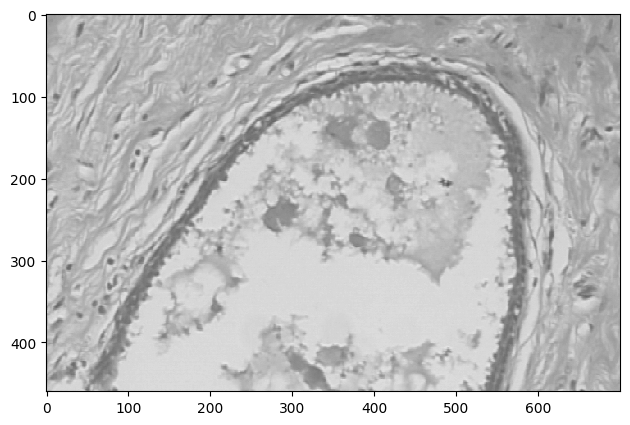

In [20]:
### Plot the corresponding gray image
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
io.imshow(gray)

This conversion from BGR to Gray is done as follows :

$$ Y ← 0.114.B + 0.587.G + 0.299.R $$

The values are then rounded to the nearest integer.

In [21]:
print("The shape of the gray image : ", gray.shape)

The shape of the gray image :  (460, 700)


Here we will calculate 3 global features on each image : Hu moments, Haralick features & the color histogram in HSV.

###### Hu moments :

We have an image (which is a $460\times700$ array), the spatial moments $m_{ij}$ are computed as :

$$ m_{ij} = \sum_{x,y} array~(x,y)~.~x^i~.~y^j $$

The central moments $mu_{ij}$ are computed as :

$$ mu_{ij} = \sum_{x,y} array~(x,y)~.~(x - \bar{x})^i~.~(y - \bar{y})^j $$
<br>Where : $ \bar{x} = \frac{m_{10}}{m_{00}} $ and $ \bar{y} = \frac{m_{01}}{m_{00}} $

The normalized central moments $nu_{ij}$ are computed as :

$$ nu_{ij} = \frac{mu_{ij}}{m_{00}^{\frac{i+j}{2}+1}} $$

There are 7 Hu moments defined as :

<img src="https://docs.opencv.org/2.4/_images/math/6f3e6a1dd05317afa7a9317d0d0e87bc3dacf7fd.png" />

In [22]:
### This function returns all the moments up to the third order :
cv2.moments(gray)

{'m00': 59467253.0,
 'm10': 20575706466.0,
 'm01': 14013333042.0,
 'm20': 9484726285306.0,
 'm11': 4866198804187.0,
 'm02': 4336908146044.0,
 'm30': 4927293544349466.0,
 'm21': 2241433480227539.0,
 'm12': 1506346345270707.0,
 'm03': 1500844349690472.0,
 'mu20': 2365519070959.069,
 'mu11': 17576869649.501904,
 'mu02': 1034695700717.0067,
 'mu30': 8630224818489.111,
 'mu21': -5785527336221.926,
 'mu12': -2510471092984.3354,
 'mu03': -8786658918977.305,
 'nu20': 0.0006689146366507764,
 'nu11': 4.970336328883509e-06,
 'nu02': 0.0002925882556544449,
 'nu30': 3.164662609074159e-07,
 'nu21': -2.1215255013395277e-07,
 'nu12': -9.205778720976532e-08,
 'nu03': -3.2220262535922636e-07}

In [23]:
### The Hu moments :
for i in range(7):
    print("hu["+str(i)+"] = ", cv2.HuMoments(cv2.moments(gray)).flatten()[i])

hu[0] =  0.0009615028923052214
hu[1] =  1.4172036200668493e-07
hu[2] =  4.499779429650015e-13
hu[3] =  3.358946166436554e-13
hu[4] =  -1.2980421047289772e-25
hu[5] =  -9.088709055272114e-17
hu[6] =  1.427759929358785e-26


In [24]:
# Given a BGR image, this function returns the Hu moments

### Step 1 : We convert the BGR image to a Gray image
### Step 2 : We calculate the moments up to the third order
### Step 3 : We calculate the Hu moments

def fd_hu_moments(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    moments = cv2.moments(gray)
    features = cv2.HuMoments(moments).flatten()
    return features

###### Haralick features :

Haralick texture features are calculated from a Gray Level Co-occurrence Matrix, (GLCM), a matrix that counts the co-occurrence of neighboring gray levels in the image. The GLCM is a square matrix that has the dimension of the number of gray levels N in the region of interest (ROI).

<img src="https://media.springernature.com/lw685/springer-static/image/art%3A10.1038%2Fs41598-017-04151-4/MediaObjects/41598_2017_4151_Fig4_HTML.jpg?as=webp" />

● <i>Step 1 :</i>
<br>The first step in texture analysis using the Haralick features is to map the gray-levels in the original image from the range [a,b], to a quantized image in the range [1,N], that has the desired number of gray-levels.

<img src="https://journals.plos.org/plosone/article/file?type=thumbnail&id=10.1371/journal.pone.0212110.e001" />

● <i>Step 2 :</i>
<br>The second step is to construct the non-normalized GLCM by counting the number of times each pair of gray-levels occurs as neighbors the image. The neighbor of a pixel is defined by a displacement vector $δ = (d_x, d_y)$. Each element $X(i, j)$, in the GLCM, is computed as :

<img src="https://journals.plos.org/plosone/article/file?type=thumbnail&id=10.1371/journal.pone.0212110.e005" />

It is possible to create a GLCM with several displacement vectors :

<img src="https://journals.plos.org/plosone/article/file?type=thumbnail&id=10.1371/journal.pone.0212110.e006" />

A GLCM created using all of these displacement vectors, e.g. by summation, is said to be direction invariant. If displacement vectors with opposite directions are used to construct the GLCM, the GLCM will be symmetric. Symmetric GLCMs are semi-direction invariant, they represent relations between pixels in e.g. vertical or horizontal directions instead of up or down, left or right. A semi-direction invariant GLCM can also be created by adding the transpose of a GLCM created by one displacement vector to itself.

We will use the semi-direction invariant GLCMs, which means that we will have 4 matrixes.

● <i>Step 3 :</i>
<br>The third step is to construct a normalized GLCM, where each element represents the estimated probability of each combination of pairs of neighboring gray-levels in the image. The normalized GLCM is computed as :

<img src="https://journals.plos.org/plosone/article/file?type=thumbnail&id=10.1371/journal.pone.0212110.e008" />

The normalized GLCM can be interpreted as a probability mass function of the gray-level pairs in the image.

● <i>Step 4 :</i>
<br>The fourth step is to compute the texture features from the normalized GLCM. The Haralick texture features are functions of the elements and their corresponding indices in the normalized GLCM.

More details in : http://haralick.org/journals/TexturalFeatures.pdf

In [25]:
### This function computes 13 features for each one of the 4 GLCMs :
mahotas.features.haralick(gray)

array([[ 1.85648331e-03,  3.66686726e+01,  9.72338918e-01,
         6.62820651e+02,  3.05072092e-01,  3.69382469e+02,
         2.61461393e+03,  7.38575605e+00,  1.06135325e+01,
         4.81078287e-04,  3.57217726e+00, -3.37971537e-01,
         9.93304318e-01],
       [ 1.41900508e-03,  8.57495862e+01,  9.35323178e-01,
         6.62908157e+02,  2.36651978e-01,  3.69401208e+02,
         2.56588304e+03,  7.37017677e+00,  1.11307149e+01,
         3.50472341e-04,  4.08883881e+00, -2.56960726e-01,
         9.81040041e-01],
       [ 1.71678760e-03,  4.25277093e+01,  9.67896615e-01,
         6.62355528e+02,  3.06946237e-01,  3.69380507e+02,
         2.60689440e+03,  7.37618133e+00,  1.06317184e+01,
         5.03353846e-04,  3.55595491e+00, -3.35111699e-01,
         9.93054150e-01],
       [ 1.51649816e-03,  6.07498075e+01,  9.54179340e-01,
         6.62908471e+02,  2.58665790e-01,  3.69401196e+02,
         2.59088408e+03,  7.37331373e+00,  1.09183399e+01,
         4.04234910e-04,  3.85609702e

In [26]:
print("Number of GLCMs : ", mahotas.features.haralick(gray).shape[0])
print("Number of features per GLCM : ", mahotas.features.haralick(gray).shape[1])

Number of GLCMs :  4
Number of features per GLCM :  13


We can also calculate the mean of the features along the 4 GLCMs. We will have a total of 13 features.

In [27]:
mahotas.features.haralick(gray).mean(axis=0)

array([ 1.62719354e-03,  5.64239439e+01,  9.57434513e-01,  6.62748202e+02,
        2.76834024e-01,  3.69391345e+02,  2.59456886e+03,  7.37635697e+00,
        1.08235764e+01,  4.34784846e-04,  3.76826700e+00, -3.05065559e-01,
        9.88760296e-01])

In [28]:
# Given a BGR image, this function returns the Haralick features

### Step 1 : We convert the BGR image to a Gray image
### Step 2 : We calculate the mean of the features along the 4 GLCMs (we have 13 features instead of 52)

def fd_haralick(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    haralick = mahotas.features.haralick(gray).mean(axis=0)
    return haralick

###### Color histogram in HSV :

In [29]:
### Convert BGR to HSV
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

<i>Difference between RGB and HSV :</i>

RGB is an additive color model in which Red, Green and, Blue are added to create whole range of colors.

<img src="https://rehanguha.github.io/articles/rgb_2.png" width=300 />

HSV stands for Hue, Saturation and Value, and it is designed in a way such that it is more closely align with the way human vision perceives color-making attributes. HSV is a cylindrical color model that remaps the RGB primary colors into dimensions that are easier for humans to understand.

<img src="https://rehanguha.github.io/articles/rgb_3.png" width=300 />

● <i>Step 1 :</i>
<br>R, G, and B are converted to the floating-point format and scaled to fit the 0 to 1 range.

● <i>Step 2 :</i>
<br>H, S and V are computed as :
$$ V \leftarrow max(R,G,B) $$

$$
S \leftarrow
\begin{cases}
  \frac{V-min(R,G,B)}{V} & \text{if } V \neq 0 \\
  0                      & \text{otherwise}
\end{cases}
$$

$$
H \leftarrow
\begin{cases}
  60.(G - B)~/~(V-min(R,G,B))       & \text{if } V = R \\
  120~+~60.(B - R)~/~(V-min(R,G,B)) & \text{if } V = G \\
  240~+~60.(R - G)~/~(V-min(R,G,B)) & \text{if } V = B \\
  0                                 & \text{if } R = G = B
\end{cases}
$$

If $H < 0$ then $H ← H + 360$. On output, we will have :  $0 ≤ V ≤ 1$ , $0 ≤ S ≤ 1$ , $0 ≤ H ≤ 360$.

● <i>Step 3 :</i>
<br>The values are then converted as follows : $V ← 255.V$ , $S ← 255.S$ , $H ← \frac{H}{2}$ (to fit to 0 to 255)

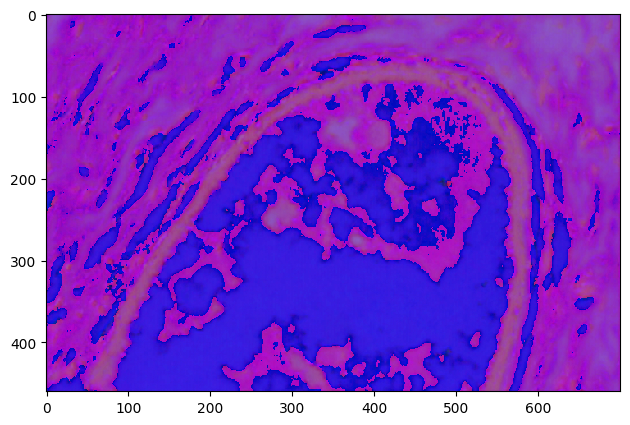

In [30]:
### Plot the hsv image
io.imshow(hsv)

In [31]:
print("The shape of the hsv image : ", hsv.shape)

The shape of the hsv image :  (460, 700, 3)


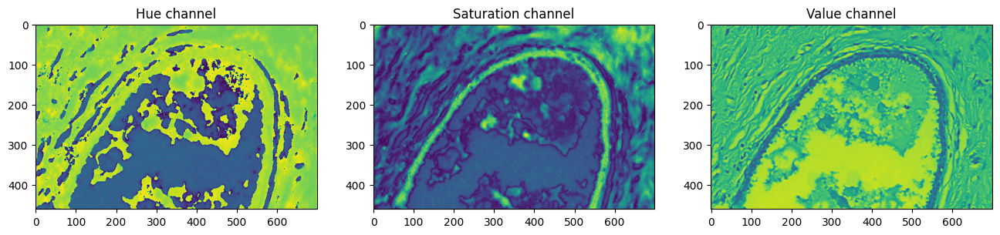

In [32]:
### Plot the HSV channels
H = hsv[:,:,0]
S = hsv[:,:,1]
V = hsv[:,:,2]

fig, axs = plt.subplots(1, 3, figsize=(16, 6))

ax = axs[0]
ax.set_title('Hue channel')
ax.imshow(H)

ax = axs[1]
ax.set_title('Saturation channel')
ax.imshow(S)

ax = axs[2]
ax.set_title('Value channel')
ax.imshow(V)

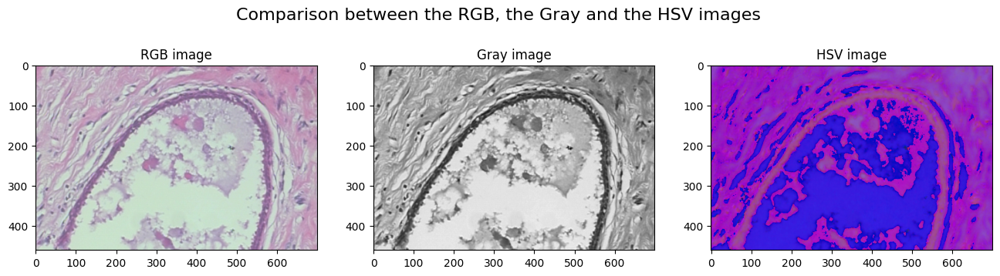

In [33]:
fig, axs = plt.subplots(1, 3, figsize=(16, 6))

fig.suptitle('Comparison between the RGB, the Gray and the HSV images', fontsize=16, y=0.82)

ax = axs[0]
ax.set_title('RGB image')
ax.imshow(img)

ax = axs[1]
ax.set_title('Gray image')
ax.imshow(gray, cmap='gray')

ax = axs[2]
ax.set_title('HSV image')
ax.imshow(hsv)

Then, we will calculate the HSV image histogram. OpenCV provides us with the <i>cv2.calcHist()</i> function to calculate the image histograms. We will use the following parameters :

● <b>images :</b> list of images as numpy arrays. All images must be of the same dtype and same size.
<br>● <b>channels :</b> list of the channels used to calculate the histograms.
<br>● <b>mask :</b> optional mask (8 bit array) of the same size as the input image.
<br>● <b>histSize :</b> histogram sizes in each dimension.
<br>● <b>ranges :</b> Array of the dims arrays of the histogram bin boundaries in each dimension.

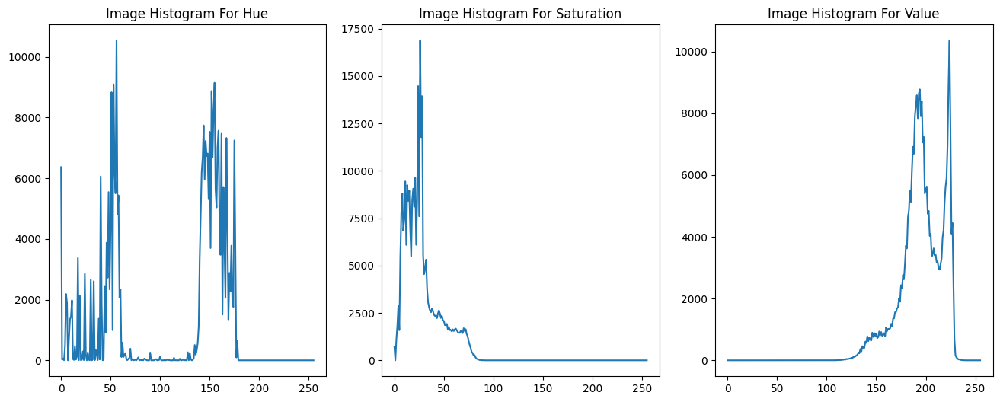

In [34]:
bins = 256

fig, axs = plt.subplots(1, 3, figsize=(16, 6))

ax = axs[0]
ax.set_title('Image Histogram For Hue')
ax.plot(cv2.calcHist([hsv],[0],None,[bins],[0,256]))

ax = axs[1]
ax.set_title('Image Histogram For Saturation')
ax.plot(cv2.calcHist([hsv],[1],None,[bins],[0,256]))

ax = axs[2]
ax.set_title('Image Histogram For Value')
ax.plot(cv2.calcHist([hsv],[2],None,[bins],[0,256]))

plt.show()

Let's take the Hue channel as an example :

In [35]:
print("Shape of the histogram : ", cv2.calcHist([hsv],[0],None,[256],[0,256]).shape)

Shape of the histogram :  (256, 1)


In [36]:
print("The number of times 10 appears in this channel : ",cv2.calcHist([hsv],[0],None,[256],[0,256]).flatten()[10].astype(int))

The number of times 10 appears in this channel :  1442


The sum of the values in the histogram should give us $460\times700$ :

In [37]:
cv2.calcHist([hsv],[0],None,[256],[0,256]).flatten().sum().astype(int) == 700 * 460

True

Now let's change the number of bins to 8 :

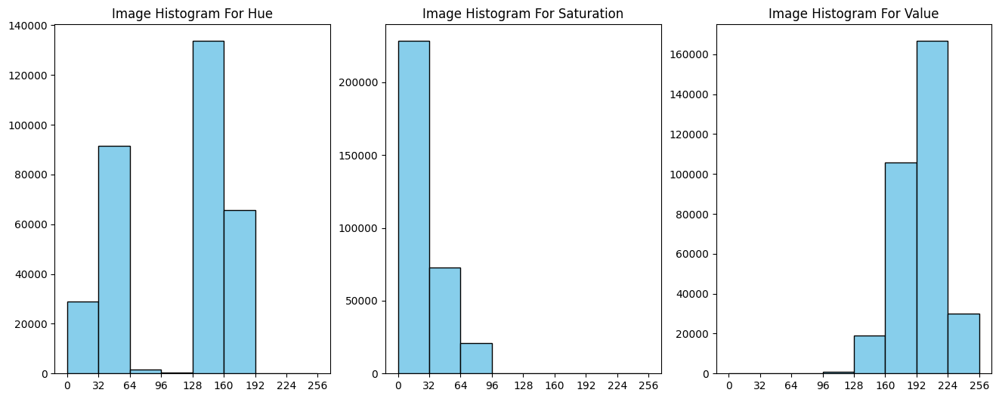

In [38]:
bins = 8

fig, axs = plt.subplots(1, 3, figsize=(16, 6))

ax = axs[0]
ax.set_title('Image Histogram For Hue')
ax.bar(x=np.linspace(0,256,9)[:-1],
       height=cv2.calcHist([hsv],[0],None,[bins],[0,256]).flatten(),
       width=np.diff(np.linspace(0,256,9)),
       align='edge',
       fc='skyblue',
       ec='black')
ax.set_xticks(np.linspace(0,256,9))

ax = axs[1]
ax.set_title('Image Histogram For Saturation')
ax.bar(x=np.linspace(0,256,9)[:-1],
       height=cv2.calcHist([hsv],[1],None,[bins],[0,256]).flatten(),
       width=np.diff(np.linspace(0,256,9)),
       align='edge',
       fc='skyblue',
       ec='black')
ax.set_xticks(np.linspace(0,256,9))

ax = axs[2]
ax.set_title('Image Histogram For Value')
ax.bar(x=np.linspace(0,256,9)[:-1],
       height=cv2.calcHist([hsv],[2],None,[bins],[0,256]).flatten(),
       width=np.diff(np.linspace(0,256,9)),
       align='edge',
       fc='skyblue',
       ec='black')
ax.set_xticks(np.linspace(0,256,9))

plt.show()

Let's take the Hue channel as an example :

In [39]:
print("Shape of the histogram : ", cv2.calcHist([hsv],[0],None,[8],[0,256]).shape)

Shape of the histogram :  (8, 1)


The first element corresponds to the number of times a value between 0 and 31 appears in the Hue channel. In the second element, we take into consideration values between 32 to 63, and so on.

In [40]:
print("0 to 31     :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[0].astype(int))
print("32 to 63    :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[1].astype(int))
print("64 to 95    :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[2].astype(int))
print("96 to 127   :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[3].astype(int))
print("128 to 159  :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[4].astype(int))
print("160 to 191  :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[5].astype(int))
print("192 to 223  :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[6].astype(int))
print("224 to 255  :  ", cv2.calcHist([hsv],[0],None,[8],[0,256]).flatten()[7].astype(int))

0 to 31     :   29032
32 to 63    :   91479
64 to 95    :   1591
96 to 127   :   443
128 to 159  :   133662
160 to 191  :   65793
192 to 223  :   0
224 to 255  :   0


What if we consider all the image and not only one channel ?

In [41]:
bins = 256
hist = cv2.calcHist([hsv], [0, 1, 2], None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
print("Shape of hist : ", hist.shape)

Shape of hist :  (256, 256, 256)


This is a 3-dimensionnal array (because we have 3 channels). The element in position i,j,k corresponds to the number of times the value $i$ appears in the Hue channel, $j$ appears in the Saturation channel and $k$ appears in the Value channel, all in the same pixel (we have 322000 pixels).

For example, if the top-left pixel in the Hue channel is equal to 0, and in the Saturation channel it is equal to 10, and in the Value channel it is equal to 20, we will have $hist~[0,10,20] = 1$. Now imagine if we have another pixel where these 3 values coexist together in the same order (0 in H, 10 in S and 20 in V), we will now have $hist~[0,10,20] = 2$, and so on.

We can do the same thing, but instead of considering numbers we will consider ranges (0 to 31, 32 to 63, ..., 224 to 255). To do that, we will choose the number of bins to be equal to 8 :

In [42]:
bins = 8
hist = cv2.calcHist([hsv], [0, 1, 2], None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
print("Shape of hist : ", hist.shape)

Shape of hist :  (8, 8, 8)


Then, we normalize this array using <i>cv2.normalize()</i> :

In [43]:
hist = cv2.normalize(hist, hist)

Finally, we flatten this array :

In [44]:
hist = hist.flatten()
print("Number of features : ", len(hist))

Number of features :  512


In [45]:
# Given a BGR image, this function returns the HSV histogram features

### Step 1 : We convert the BGR image to an HSV image
### Step 2 : We calculate an histogram features using calcHist (the output is a (bins,bins,bins) matrix)
### Step 3 : We normalize and flatten this array

def fd_histogram(image, mask=None):
    image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hist  = cv2.calcHist([image], [0, 1, 2], None, [bins, bins, bins], [0, 256, 0, 256, 0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

###### Our features :

In [46]:
hu_moments = fd_hu_moments(img)
haralick_features = fd_haralick(img)
histogram_features = fd_histogram(img, mask=None)

print("Number of the features : ", len(hu_moments)+len(haralick_features)+len(histogram_features))

Number of the features :  532


We concatenate the features for each image in the list to create a DataFrame with these features. Note that there are 7 values for the Hu moments, 13 for the Haralick features and 512 for the histogram. At the end, the DataFrame contains 532 features and 422 samples.

In [47]:
# Compute the features
feat_hu = []
feat_haralick = []
feat_histogram = []

for i in train_images:
    img = cv2.imread('data-challenge/Train/' + i)  # Load image
    feat_hu.append(fd_hu_moments(img))  # Append Hu values
    feat_haralick.append(fd_haralick(img))  # Append Haralick values
    feat_histogram.append(fd_histogram(img))  # Append Histogram values

In [48]:
# The features DataFrame
df_features = np.hstack([feat_haralick, feat_hu, feat_histogram])
df_features = pd.DataFrame(df_features)
df_features.shape

(422, 532)

In [49]:
print("Number of images   : ", df_features.shape[0])
print("Number of features : ", df_features.shape[1])

Number of images   :  422
Number of features :  532


In [50]:
df_features

,0,1,2,3,4,5,6,7,8,9,...,522,523,524,525,526,527,528,529,530,531
0,0.002159,56.342601,0.957225,658.536578,0.285724,368.130680,2577.803709,7.345296,10.541800,0.000437,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.001479,56.489012,0.952225,591.148607,0.263477,361.274977,2308.105416,7.320420,10.625002,0.000410,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000891,77.383048,0.944581,698.171173,0.236460,355.468091,2715.301645,7.581967,11.145510,0.000348,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000831,104.921993,0.937596,840.643381,0.188244,354.103247,3257.651532,7.658306,11.474236,0.000271,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.001277,68.442074,0.946159,635.620753,0.255009,360.947441,2474.040937,7.403313,10.811924,0.000393,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
417,0.001084,90.199284,0.967643,1393.740553,0.236030,324.997978,5484.762930,7.702850,11.214430,0.000321,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
418,0.000962,130.097530,0.952844,1379.382435,0.226041,328.563393,5387.432208,7.701500,11.378433,0.000315,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
419,0.000698,78.016717,0.957054,908.311793,0.201126,303.955233,3555.230455,7.594811,11.258012,0.000291,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
420,0.000507,115.440718,0.945563,1060.279872,0.145113,329.516178,4125.678771,7.709068,11.698973,0.000225,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Machine Learning :

We have the features, we have the labels, it's time to apply some Machine Learning !!! &#x1F600;

In [51]:
y_train = df['type_id'].astype(int)

###### Apply PCA :

Principal Component Analysis (PCA) is an unsupervised, non-parametric statistical technique primarily used for dimensionality reduction in machine learning.

High dimensionality means that the dataset has a large number of features. The primary problem associated with high-dimensionality in the machine learning field is model overfitting, which reduces the ability to generalize beyond the examples in the training set. Richard Bellman described this phenomenon in 1961 as the Curse of Dimensionality where <i>"Many algorithms that work fine in low dimensions become intractable when the input is high-dimensional."</i>

PCA identifies a list of the principal axes to describe the underlying dataset before ranking them according to the amount of variance captured by each. It is an unsupervised learning algorithm as the directions of these components is calculated purely from the explanatory feature set without any reference to response variables.

● <i>First : We eliminate variables with a standard deviation that is equal to 0 (these variables are constants)</i>

In [52]:
list_features = list(np.where(np.abs(df_features.std(axis=0)) != 0)[0])

In [53]:
X_train = df_features.iloc[: , list_features]

● <i>Second : we standardize X_train</i>

In [54]:
scaler = StandardScaler()
X_train_norm = scaler.fit_transform(X_train)

In [55]:
### Mean
np.all(X_train_norm.mean(axis=0) < 1e-10)

True

In [56]:
### Standard Deviation
np.all(np.abs(X_train_norm.std(axis=0) - 1) < 1e-10)

True

In [57]:
# Covariance matrix
Cov_Mat = np.cov(X_train_norm.T)

# eigenvalues
eig_val = np.flip(np.linalg.eigh(Cov_Mat)[0], axis=0)

# Rank of the covariance matrix
Cov_Mat_rank = np.linalg.matrix_rank(Cov_Mat)
print("Rank of the covariance matrix: ", Cov_Mat_rank)
print("Number of variables : ", Cov_Mat.shape[0])

Rank of the covariance matrix:  257
Number of variables :  315


The rank of the covariance matrix (257) is less than the number of columns (315), which means that the covariance matrix is singular.

In [58]:
eig_val = eig_val[:Cov_Mat_rank]

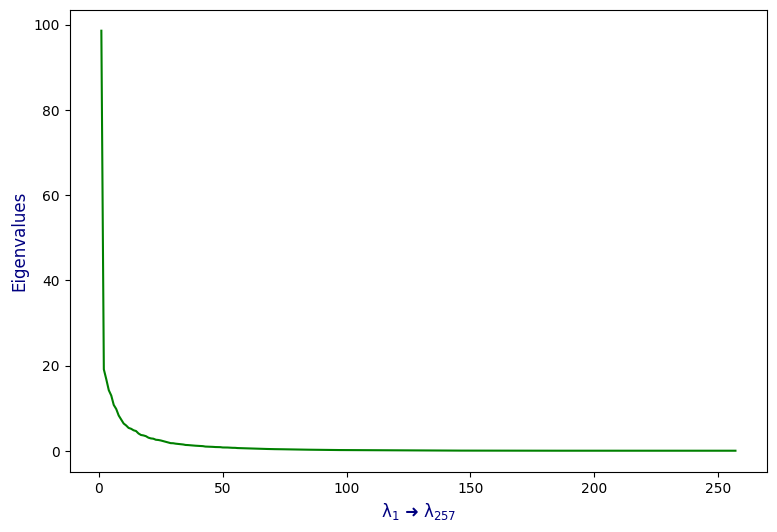

In [59]:
fig = plt.figure(figsize=(9,6))
plt.plot([i for i in range(1, Cov_Mat_rank + 1)], eig_val, color='green')
plt.xlabel("λ$_{%d}$"%1+" ➜ λ$_{%d}$"%Cov_Mat_rank, color='navy', fontsize=12)
plt.ylabel("Eigenvalues", color='navy', fontsize=12)

plt.show()

In [60]:
total_inertia = eig_val.sum()
inertia_proportions = [val/total_inertia for val in eig_val]

df_proportions = pd.DataFrame(data = {'Eigenvalues': list(np.around(eig_val, 5)),
                                      'Proportions of the total inertia': list(np.around(np.array(inertia_proportions), 5)),
                                      'Cumulative proportions' : list(np.around(np.cumsum(inertia_proportions), 5))},
                              index = ['Component '+str(i) for i in range(1, Cov_Mat_rank + 1)],)

df_proportions

,Eigenvalues,Proportions of the total inertia,Cumulative proportions
Component 1,98.57615,0.31220,0.31220
Component 2,19.09627,0.06048,0.37268
Component 3,16.74753,0.05304,0.42572
Component 4,14.20235,0.04498,0.47070
Component 5,12.94899,0.04101,0.51171
...,...,...,...
Component 253,0.00000,0.00000,1.00000
Component 254,0.00000,0.00000,1.00000
Component 255,0.00000,0.00000,1.00000
Component 256,0.00000,0.00000,1.00000


The optimal number of principal components is determined by looking at the cumulative explained variance ratio as a function of the number of components. The choice of PCs is entirely dependent on the tradeoff between dimensionality reduction and information loss. In the graph below, we can see that with only 60 principal components, we can explain 95% of the total variance.

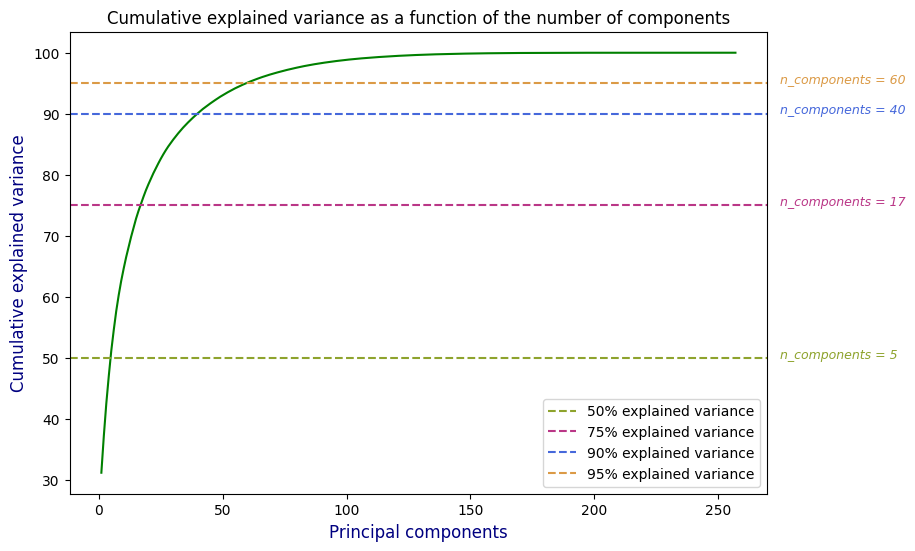

In [61]:
fig = plt.figure(figsize=(9,6))

plt.plot([i for i in range(1, Cov_Mat_rank + 1)], df_proportions['Cumulative proportions']*100, color='green')

plt.axhline(y=50, xmin=0, xmax=1, linestyle='--', color='#8EA32D', label="50% explained variance")
plt.axhline(y=75, xmin=0, xmax=1, linestyle='--', color='#BA3787', label="75% explained variance")
plt.axhline(y=90, xmin=0, xmax=1, linestyle='--', color='#4668DB', label="90% explained variance")
plt.axhline(y=95, xmin=0, xmax=1, linestyle='--', color='#DB9A46', label="95% explained variance")

plt.text(275, 50, "n_components = "+df_proportions['Cumulative proportions'].gt(0.50).idxmax()[10:], 
         fontstyle='italic', color='#8EA32D', fontsize=9)

plt.text(275, 75, "n_components = "+df_proportions['Cumulative proportions'].gt(0.75).idxmax()[10:], 
         fontstyle='italic', color='#BA3787', fontsize=9)

plt.text(275, 90, "n_components = "+df_proportions['Cumulative proportions'].gt(0.90).idxmax()[10:], 
         fontstyle='italic', color='#4668DB', fontsize=9)

plt.text(275, 95, "n_components = "+df_proportions['Cumulative proportions'].gt(0.95).idxmax()[10:], 
         fontstyle='italic', color='#DB9A46', fontsize=9)

plt.xlabel("Principal components", color='navy', fontsize=12)
plt.ylabel("Cumulative explained variance", color='navy', fontsize=12)
plt.title("Cumulative explained variance as a function of the number of components")

plt.legend()

plt.show()

We want to apply PCA such that the amount of variance that needs to be explained is greater than 0.95 :

In [62]:
pca = PCA(n_components = 0.95)
X_train_pca = pca.fit_transform(X_train_norm)

In [63]:
print("Number of principal components : ", pca.n_components_)

Number of principal components :  60


In [64]:
df_proportions.iloc[:pca.n_components_]

,Eigenvalues,Proportions of the total inertia,Cumulative proportions
Component 1,98.57615,0.31220,0.31220
Component 2,19.09627,0.06048,0.37268
Component 3,16.74753,0.05304,0.42572
Component 4,14.20235,0.04498,0.47070
Component 5,12.94899,0.04101,0.51171
Component 6,10.74595,0.03403,0.54574
Component 7,9.79204,0.03101,0.57675
Component 8,8.26527,0.02618,0.60293
Component 9,7.30193,0.02313,0.62606
Component 10,6.38806,0.02023,0.64629


Let's create a function that takes a dataframe and the amount of explained variance as arguments, and returns a new dataframe after applying PCA :

In [65]:
def apply_pca(df, explained_variance):
    
    scaler = StandardScaler()
    pca = PCA(n_components = explained_variance)
    
    list_features = list(np.where(np.abs(df.std(axis=0)) != 0)[0])
    
    X_train = df.iloc[: , list_features]
    X_train_norm = scaler.fit_transform(X_train)
    X_train_pca = pca.fit_transform(X_train_norm)
    
    return X_train_pca

###### Deal with the class imbalance :

Most machine learning algorithms work best when the number of samples in each class is about equal. This is because most algorithms are designed to maximize accuracy and reduce errors.

However, if the dataframe has imbalanced classes, then In such cases, you get a pretty high accuracy just by predicting the majority class, but you fail to capture the minority class, which is most often the point of creating the model in the first place.

In [66]:
print(tabulate([[i, Counter(y_train)[i]] for i in range(1,9)],
               headers=["Class","Number of samples"]))

  Class    Number of samples
-------  -------------------
      1                   72
      2                   46
      3                   92
      4                   57
      5                   58
      6                   16
      7                   65
      8                   16


From the table above, we can say that we must deal with the problem of imbalanced classes because the distibution of our classes is not equal. For example, we have 92 samples on the third class and only 16 classes on the sixth and eigth classes.

One way to deal with this is to assign weights to our classes. The minority class will have the biggest weight and the majority class will have the smallest weight. Then, we could pass the weights to the fit method. The disadvantage of this technique is that not all the algorithms support the <i>sample_weight</i> parameter.

One of the widely adopted class imbalance techniques for dealing with highly unbalanced datasets is called resampling. It consists of removing samples from the majority class (under-sampling) and/or adding more examples from the minority class (over-sampling).

The simplest implementation of over-sampling is to duplicate random records from the minority class, which can cause overfishing.

In under-sampling, the simplest technique involves removing random records from the majority class, which can cause a loss of information.

However, we can use many resampling techniques using the <i>imblearn</i> library. We will try the <b>SMOTE</b> (Synthetic Minority Oversampling Technique) and the <b>ADASYN</b> (Adaptive Synthetic Sampling Approach) algorithms.

<img src="https://miro.medium.com/v2/resize:fit:828/format:webp/1*1i7SEN4dg9dkjYoaci6QBg.png" width=600 />

<b>SMOTE</b> is an oversampling technique where the synthetic samples are generated for the classes that are not majority classes. This algorithm helps to overcome the overfitting problem posed by random oversampling. It focuses on the feature space to generate new instances with the help of interpolation between the positive instances that lie together.

<b>ADASYN</b> is a generalized form of the SMOTE algorithm. This algorithm also aims to oversample the classes that are not majority classes by generating synthetic instances for it. But the difference here is it considers the density distribution, $r_i$ which decides the number of synthetic instances generated for samples which difficult to learn. Due to this, it helps in adaptively changing the decision boundaries based on the samples difficult to learn. This is the major difference compared to SMOTE.

We will try these algorithms as well as the sample_weight option (for the algorithms that support this parameter).

Let's define the samples weights :

In [67]:
### Class weights = Inverse of class counts
class_weights = dict(sorted({k: 1/v for k, v in dict(Counter(y_train)).items()}.items()))
print(tabulate([[i, class_weights[i]] for i in range(1,9)],
               headers=["Class","Weight"]))

  Class     Weight
-------  ---------
      1  0.0138889
      2  0.0217391
      3  0.0108696
      4  0.0175439
      5  0.0172414
      6  0.0625
      7  0.0153846
      8  0.0625


In [68]:
samples_weights = [class_weights[y] for y in y_train]

It's generally recommended to <b>handle imbalanced data after applying PCA</b>. In fact, classification using class-imbalanced data is biased in favor of the majority class. The bias is even larger for high-dimensional data, where the number of variables greatly exceeds the number of samples.

For more details : https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3648438/

Let's perform the SMOTE and ADASYN over-sampling techniques :

In [69]:
# SMOTE
smote = SMOTE(random_state=10)
X_train_smote, y_train_smote = smote.fit_resample(X_train_pca, y_train)

print(tabulate([[i, Counter(y_train_smote)[i]] for i in range(1,9)],
               headers=["Class","Number of samples"]))

  Class    Number of samples
-------  -------------------
      1                   92
      2                   92
      3                   92
      4                   92
      5                   92
      6                   92
      7                   92
      8                   92


In [70]:
# ADASYN
adasyn = ADASYN(random_state=11)
X_train_adasyn, y_train_adasyn = adasyn.fit_resample(X_train_pca, y_train)

print(tabulate([[i, Counter(y_train_adasyn)[i]] for i in range(1,9)],
               headers=["Class","Number of samples"]))

  Class    Number of samples
-------  -------------------
      1                   84
      2                   90
      3                   92
      4                   89
      5                   90
      6                   93
      7                   93
      8                   93


In the following plot, we can see the impact of over-sampling with SMOTE and ADASYN on the distributions of the classes.

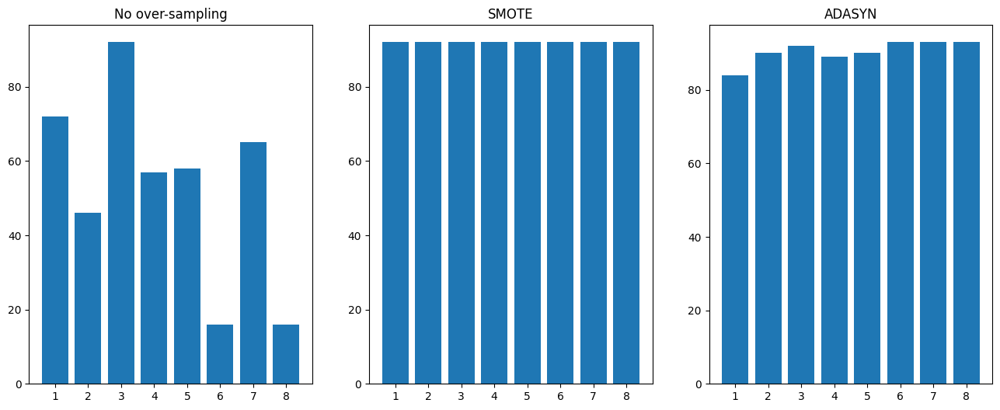

In [71]:
fig, axs = plt.subplots(1, 3, figsize=(16, 6))

ax = axs[0]
ax.set_title('No over-sampling')
ax.bar(x=y_train.value_counts().sort_index().index,
       height=y_train.value_counts().sort_index().values)
ax.set_xticks(range(1,9))

ax = axs[1]
ax.set_title('SMOTE')
ax.bar(x=y_train_smote.value_counts().sort_index().index,
       height=y_train_smote.value_counts().sort_index().values)
ax.set_xticks(range(1,9))

ax = axs[2]
ax.set_title('ADASYN')
ax.bar(x=y_train_adasyn.value_counts().sort_index().index,
       height=y_train_adasyn.value_counts().sort_index().values)
ax.set_xticks(range(1,9))

plt.show()

Next, we will use cross-validation in order to choose the best hyperparameters in several models (KNN, Decision tree ...). To do that, we can use the <b>GridSearchCV</b> class in sklearn.

GridSearchCV is the process of performing hyperparameter tuning in order to determine the optimal values for a given model. The performance of a model significantly depends on the value of hyperparameters. Note that there is no way to know in advance the best values for hyperparameters so ideally, we need to try all possible values to know the optimal values. Doing this manually could take a considerable amount of time and resources and thus we use GridSearchCV to automate the tuning of hyperparameters.

GridSearchCV tries all the combinations of the values passed in the dictionary and evaluates the model for each combination using the Cross-Validation method. Hence after using this function we get accuracy/loss for every combination of hyperparameters and we can choose the one with the best performance.

###### KNN :

The parameters to tune are :

● <i>n_neighbors : </i>Number of neighbors to use.

● <i>weights : </i>Weight function used in prediction. If we use <i>'uniform'</i>, then all the points in each neighborhood are weighted equally. If we use <i>'distance'</i>, then the weight of a neighbor is the inverse of the distance between the point and this neighbor. in this case, closer neighbors of a query point will have a greater influence than neighbors which are further away.

● <i>p : </i>Power parameter for the Minkowski metric. When p = 1, this is equivalent to using manhattan_distance (l1), and euclidean_distance (l2) for p = 2.

The fit method in the KNN algorithm doesn't support the <i>'sample_weight'</i> parameter.

In [72]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"weights": ["uniform","distance"], "p": [1,2], "n_neighbors": list(range(1,21))}
]

# Create a KNN classifier
knn = KNeighborsClassifier()

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_knn = GridSearchCV(estimator=knn, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_knn_smote = GridSearchCV(estimator=knn, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_knn_adasyn = GridSearchCV(estimator=knn, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
grid_search_knn.fit(X_train_pca, y_train)
grid_search_knn_smote.fit(X_train_smote, y_train_smote)
grid_search_knn_adasyn.fit(X_train_adasyn, y_train_adasyn)

print("Best parameters (No over-sampling) : ", grid_search_knn.best_params_)
print("Best score (No over-sampling) : ", grid_search_knn.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_knn_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_knn_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_knn_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_knn_adasyn.best_score_)

Best parameters (No over-sampling) :  {'n_neighbors': 1, 'p': 2, 'weights': 'uniform'}
Best score (No over-sampling) :  0.7961814914645102

Best parameters (SMOTE) :  {'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}
Best score (SMOTE) :  0.9225543478260869

Best parameters (ADASYN) :  {'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}
Best score (ADASYN) :  0.9378453038674033


We will choose the ADASYN implementation.

In [73]:
# Pick the best model
models = [grid_search_knn, grid_search_knn_smote, grid_search_knn_adasyn]
scores = [model.best_score_ for model in models]

best_model = models[np.array(scores).argmax()]

# Plot the score as a function of the values of the hyperparameters
fig = go.Figure()

fig.add_trace(go.Scatter(x=list(range(1,21)),
         y=best_model.cv_results_['mean_test_score'][::4],
         name="weights = 'uniform' & p = 1",
         mode='lines+markers',
         hovertemplate="weights = 'uniform'<br>p = 1<br>Number of neighbors = %{x}<br>Score = %{y}<extra></extra>"))

fig.add_trace(go.Scatter(x=list(range(1,21)),
         y=best_model.cv_results_['mean_test_score'][1::4],
         name="weights = 'distance' & p = 1",
         mode='lines+markers',
         hovertemplate="weights = 'distance'<br>p = 1<br>Number of neighbors = %{x}<br>Score = %{y}<extra></extra>"))

fig.add_trace(go.Scatter(x=list(range(1,21)),
         y=best_model.cv_results_['mean_test_score'][2::4],
         name="weights = 'uniform' & p = 2",
         mode='lines+markers',
         hovertemplate="weights = 'uniform'<br>p = 2<br>Number of neighbors = %{x}<br>Score = %{y}<extra></extra>"))

fig.add_trace(go.Scatter(x=list(range(1,21)),
         y=best_model.cv_results_['mean_test_score'][3::4],
         name="weights = 'distance' & p = 2",
         mode='lines+markers',
         hovertemplate="weights = 'distance'<br>p = 2<br>Number of neighbors = %{x}<br>Score = %{y}<extra></extra>"))

fig.update_xaxes(title="Number of neighbors", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_yaxes(title="Score on the the test fold", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_layout(title="GridSearchCV results (cv = 4)",
                  title_x=0.5,
                  title_font_family="Times New Roman",
                  title_font_size=22,
                  title_font_color="darkred",
                  xaxis_range=[0,21],
                  xaxis=dict(tickvals=list(range(1, 21))),
                  margin={"t": 35, "b": 20, "l": 0, "r": 0},
                  height=600,
                  showlegend=True,
                  legend=dict(orientation="h"))

fig.show()

###### Logistic regression :

The parameters to tune are :

● <i>penalty : </i>We will choose either to add a L1 or a L2 penalty term.

● <i>class_weight : </i>Weights associated with classes. If not given, all classes are supposed to have weight one. If 'balanced', we automatically adjust weights inversely proportional to class frequencies in the input data as <i>n_samples / (n_classes * np.bincount(y))</i>.

● <i>C : </i>Inverse of regularization strength; must be a positive float. Like in support vector machines, smaller values specify stronger regularization.

The fit method in the Logistic Regression algorithm supports the <i>'sample_weight'</i> parameter.

In [103]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"penalty": ["l1","l2"], "class_weight": [None,"balanced"], "C": list(np.around(np.linspace(0.1, 5, num=1), 1))}
]

# Create a Logistic Regression classifier
logreg = LogisticRegression(solver='liblinear', multi_class='ovr', max_iter=100000)

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_logreg = GridSearchCV(estimator=logreg, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_logreg_smote = GridSearchCV(estimator=logreg, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_logreg_adasyn = GridSearchCV(estimator=logreg, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_logreg_sw = GridSearchCV(estimator=logreg, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
grid_search_logreg.fit(X_train_pca, y_train)
grid_search_logreg_smote.fit(X_train_smote, y_train_smote)
grid_search_logreg_adasyn.fit(X_train_adasyn, y_train_adasyn)
grid_search_logreg_sw.fit(X_train_pca, y_train, sample_weight=samples_weights)

print("Best parameters (No over-sampling) : ", grid_search_logreg.best_params_)
print("Best score (No over-sampling) : ", grid_search_logreg.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_logreg_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_logreg_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_logreg_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_logreg_adasyn.best_score_)

print("\nBest parameters (sample_weight) : ", grid_search_logreg_sw.best_params_)
print("Best score (sample_weight) : ", grid_search_logreg_sw.best_score_)

Best parameters (No over-sampling) :  {'C': 0.2, 'class_weight': None, 'penalty': 'l2'}
Best score (No over-sampling) :  0.7297619047619048

Best parameters (SMOTE) :  {'C': 4.9, 'class_weight': None, 'penalty': 'l1'}
Best score (SMOTE) :  0.8491847826086956

Best parameters (ADASYN) :  {'C': 4.2, 'class_weight': 'balanced', 'penalty': 'l1'}
Best score (ADASYN) :  0.8577348066298343

Best parameters (sample_weight) :  {'C': 4.2, 'class_weight': None, 'penalty': 'l2'}
Best score (sample_weight) :  0.6872641509433963


We will choose the ADASYN implementation.

In [104]:
# Pick the best model
models = [grid_search_logreg, grid_search_logreg_smote, grid_search_logreg_adasyn, grid_search_logreg_sw]
scores = [model.best_score_ for model in models]

best_model = models[np.array(scores).argmax()]

# Plot the score as a function of the values of the hyperparameters
fig = go.Figure()

fig.add_trace(go.Scatter(x=np.around(np.linspace(0.1, 5, num=50), 1),
                    y=best_model.cv_results_['mean_test_score'][::4],
                    name="class_weight = None & penalty = 'l1'",
                    mode='lines+markers',
                    hovertemplate="class_weight = None<br>penalty = 'l1'<br>C = %{x}<br>Score = %{y}<extra></extra>"))

fig.add_trace(go.Scatter(x=np.around(np.linspace(0.1, 5, num=50), 1),
                    y=best_model.cv_results_['mean_test_score'][1::4],
                    name="class_weight = None & penalty = 'l2'",
                    mode='lines+markers',
                    hovertemplate="class_weight = None<br>penalty = 'l2'<br>C = %{x}<br>Score = %{y}<extra></extra>"))

fig.add_trace(go.Scatter(x=np.around(np.linspace(0.1, 5, num=50), 1),
                    y=best_model.cv_results_['mean_test_score'][2::4],
                    name="class_weight = 'balanced' & penalty = 'l1'",
                    mode='lines+markers',
                    hovertemplate="class_weight = 'balanced'<br>penalty = 'l1'<br>C = %{x}<br>Score = %{y}<extra></extra>"))

fig.add_trace(go.Scatter(x=np.around(np.linspace(0.1, 5, num=50), 1),
                    y=best_model.cv_results_['mean_test_score'][3::4],
                    name="class_weight = 'balanced' & penalty = 'l2'",
                    mode='lines+markers',
                    hovertemplate="class_weight = 'balanced'<br>penalty = 'l2'<br>C = %{x}<br>Score = %{y}<extra></extra>"))

fig.update_xaxes(title="Regularization parameter C", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_yaxes(title="Score on the the test fold", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_layout(title="GridSearchCV results (cv = 4)",
                  title_x=0.5,
                  title_font_family="Times New Roman",
                  title_font_size=22,
                  title_font_color="darkred",
                  xaxis_range=[0,5.1],
                  xaxis=dict(tickvals=[0.1,0.5,1,1.5,2,2.5,3,3.5,4,4.5,5]),
                  margin={"t": 35, "b": 20, "l": 0, "r": 0},
                  height=600,
                  showlegend=True,
                  legend=dict(orientation="h"))

fig.show()

###### Decision tree :

The parameters to tune are :

● <i>criterion : </i>The function to measure the quality of a split. We will take 'gini' and 'entropy'.

● <i>splitter : </i>The strategy used to choose the split at each node. Supported strategies are “best” to choose the best split and “random” to choose the best random split.

● <i>max_depth : </i>The maximum depth of the tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than <i>min_samples_split</i> samples.

● <i>max_features : </i>The number of features to consider when looking for the best split.

The fit method in the Decision Tree algorithm supports the <i>'sample_weight'</i> parameter.

In [76]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"criterion": ["gini","entropy"],
     "splitter": ["best","random"],
     "max_depth": list(range(2, 21)),
     "max_features": list(range(1, 11))}
]

# Create a Decision Tree classifier
decision_tree = DecisionTreeClassifier()

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_dt = GridSearchCV(estimator=decision_tree, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_dt_smote = GridSearchCV(estimator=decision_tree, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_dt_adasyn = GridSearchCV(estimator=decision_tree, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_dt_sw = GridSearchCV(estimator=decision_tree, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
grid_search_dt.fit(X_train_pca, y_train)
grid_search_dt_smote.fit(X_train_smote, y_train_smote)
grid_search_dt_adasyn.fit(X_train_adasyn, y_train_adasyn)
grid_search_dt_sw.fit(X_train_pca, y_train, sample_weight=samples_weights)

print("Best parameters (No over-sampling) : ", grid_search_dt.best_params_)
print("Best score (No over-sampling) : ", grid_search_dt.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_dt_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_dt_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_dt_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_dt_adasyn.best_score_)

print("\nBest parameters (sample_weight) : ", grid_search_dt_sw.best_params_)
print("Best score (sample_weight) : ", grid_search_dt_sw.best_score_)

Best parameters (No over-sampling) :  {'criterion': 'entropy', 'max_depth': 18, 'max_features': 10, 'splitter': 'best'}
Best score (No over-sampling) :  0.6090296495956873

Best parameters (SMOTE) :  {'criterion': 'entropy', 'max_depth': 16, 'max_features': 9, 'splitter': 'best'}
Best score (SMOTE) :  0.7608695652173914

Best parameters (ADASYN) :  {'criterion': 'gini', 'max_depth': 16, 'max_features': 9, 'splitter': 'best'}
Best score (ADASYN) :  0.7720994475138122

Best parameters (sample_weight) :  {'criterion': 'entropy', 'max_depth': 18, 'max_features': 10, 'splitter': 'best'}
Best score (sample_weight) :  0.6256289308176102


We will choose the ADASYN implementation.

In [77]:
# Pick the best model
models = [grid_search_dt, grid_search_dt_smote, grid_search_dt_adasyn, grid_search_dt_sw]
scores = [model.best_score_ for model in models]

best_model = models[np.array(scores).argmax()]

In [78]:
fig = go.Figure()

for i in range(1,11):
    fig.add_trace(go.Scatter(x=list(range(2,21)),
                     y=best_model.cv_results_['mean_test_score'][::2][:190][i-1::10],
                     name="Max_features = "+str(i),
                     mode='lines+markers',
                     hovertemplate='max_depth = %{x}<br>max_features = '+str(i)+'<br>Score = %{y}<extra></extra>'))

fig.update_xaxes(title="Maximum depth of the tree", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_yaxes(title="Score on the the test fold", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_layout(title="GridSearchCV results (cv = 4) with criterion='gini' and splitter='best'",
                  title_x=0.5,
                  title_font_family="Times New Roman",
                  title_font_size=22,
                  title_font_color="darkred",
                  xaxis_range=[1,21],
                  xaxis=dict(tickvals=list(range(2, 21))),
                  margin={"t": 35, "b": 20, "l": 0, "r": 0},
                  height=600,
                  showlegend=True,
                  legend=dict(orientation="h"))

fig.show()

In [79]:
fig = go.Figure()

for i in range(1,11):
    fig.add_trace(go.Scatter(x=list(range(2,21)),
                     y=best_model.cv_results_['mean_test_score'][::2][190:][i-1::10],
                     name="Max_features = "+str(i),
                     mode='lines+markers',
                     hovertemplate='max_depth = %{x}<br>max_features = '+str(i)+'<br>Score = %{y}<extra></extra>'))

fig.update_xaxes(title="Maximum depth of the tree", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_yaxes(title="Score on the the test fold", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_layout(title="GridSearchCV results (cv = 4) with criterion='entropy' and splitter='best'",
                  title_x=0.5,
                  title_font_family="Times New Roman",
                  title_font_size=22,
                  title_font_color="darkred",
                  xaxis_range=[1,21],
                  xaxis=dict(tickvals=list(range(2, 21))),
                  margin={"t": 35, "b": 20, "l": 0, "r": 0},
                  height=600,
                  showlegend=True,
                  legend=dict(orientation="h"))

fig.show()

In [80]:
fig = go.Figure()

for i in range(1,11):
    fig.add_trace(go.Scatter(x=list(range(2,21)),
                     y=best_model.cv_results_['mean_test_score'][1::2][:190][i-1::10],
                     name="Max_features = "+str(i),
                     mode='lines+markers',
                     hovertemplate='max_depth = %{x}<br>max_features = '+str(i)+'<br>Score = %{y}<extra></extra>'))

fig.update_xaxes(title="Maximum depth of the tree", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_yaxes(title="Score on the the test fold", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_layout(title="GridSearchCV results (cv = 4) with criterion='gini' and splitter='random'",
                  title_x=0.5,
                  title_font_family="Times New Roman",
                  title_font_size=22,
                  title_font_color="darkred",
                  xaxis_range=[1,21],
                  xaxis=dict(tickvals=list(range(2, 21))),
                  margin={"t": 35, "b": 20, "l": 0, "r": 0},
                  height=600,
                  showlegend=True,
                  legend=dict(orientation="h"))

fig.show()

In [81]:
fig = go.Figure()

for i in range(1,11):
    fig.add_trace(go.Scatter(x=list(range(2,21)),
                     y=best_model.cv_results_['mean_test_score'][1::2][190:][i-1::10],
                     name="Max_features = "+str(i),
                     mode='lines+markers',
                     hovertemplate='max_depth = %{x}<br>max_features = '+str(i)+'<br>Score = %{y}<extra></extra>'))

fig.update_xaxes(title="Maximum depth of the tree", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_yaxes(title="Score on the the test fold", 
                 title_font=dict(size=20, family='Open Sans', color='#546E09'))

fig.update_layout(title="GridSearchCV results (cv = 4) with criterion='entropy' and splitter='random'",
                  title_x=0.5,
                  title_font_family="Times New Roman",
                  title_font_size=22,
                  title_font_color="darkred",
                  xaxis_range=[1,21],
                  xaxis=dict(tickvals=list(range(2, 21))),
                  margin={"t": 35, "b": 20, "l": 0, "r": 0},
                  height=600,
                  showlegend=True,
                  legend=dict(orientation="h"))

fig.show()

###### SVM :

The parameters to tune are :

● <i>C : </i>Regularization parameter. The strength of the regularization is inversely proportional to C. Must be strictly positive. The penalty is a squared l2 penalty.

● <i>kernel : </i>Specifies the kernel type to be used in the algorithm. If none is given, 'rbf' will be used.

● <i>class_weight : </i>If not given, all classes are supposed to have weight one. The "balanced" mode uses the values of y to automatically adjust weights inversely proportional to class frequencies in the input data as <i>n_samples / (n_classes * np.bincount(y))</i>.

● <i>degree : </i>Degree of the polynomial kernel function ('poly'). Must be non-negative. Ignored by all other kernels.

● <i>gamma : </i>Kernel coefficient for 'rbf', 'poly' and 'sigmoid'.

The fit method in the SVM algorithm supports the <i>'sample_weight'</i> parameter.

In [82]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"C": list(np.around(np.linspace(0.1, 5, num=50), 1)),
     "kernel": ["linear"],
     "class_weight": [None,"balanced"]},
    {"C": list(np.around(np.linspace(0.1, 5, num=50), 1)),
     "kernel": ["poly"],
     "degree": [1,2,3],
     "gamma": [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
     "class_weight": [None,"balanced"]},
    {"C": list(np.around(np.linspace(0.1, 5, num=50), 1)),
     "kernel": ["rbf","sigmoid"],
     "gamma": [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
     "class_weight": [None,"balanced"]}
]

# Create a SVM classifier
svm = SVC(probability=True)

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_svm = GridSearchCV(estimator=svm, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_svm_smote = GridSearchCV(estimator=svm, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_svm_adasyn = GridSearchCV(estimator=svm, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_svm_sw = GridSearchCV(estimator=svm, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
grid_search_svm.fit(X_train_pca, y_train)
grid_search_svm_smote.fit(X_train_smote, y_train_smote)
grid_search_svm_adasyn.fit(X_train_adasyn, y_train_adasyn)
grid_search_svm_sw.fit(X_train_pca, y_train, sample_weight=samples_weights)

print("Best parameters (No over-sampling) : ", grid_search_svm.best_params_)
print("Best score (No over-sampling) : ", grid_search_svm.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_svm_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_svm_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_svm_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_svm_adasyn.best_score_)

print("\nBest parameters (sample_weight) : ", grid_search_svm_sw.best_params_)
print("Best score (sample_weight) : ", grid_search_svm_sw.best_score_)

Best parameters (No over-sampling) :  {'C': 0.3, 'class_weight': None, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly'}
Best score (No over-sampling) :  0.7962938005390836

Best parameters (SMOTE) :  {'C': 0.6, 'class_weight': None, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly'}
Best score (SMOTE) :  0.9130434782608695

Best parameters (ADASYN) :  {'C': 1.1, 'class_weight': None, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly'}
Best score (ADASYN) :  0.930939226519337

Best parameters (sample_weight) :  {'C': 0.3, 'class_weight': None, 'degree': 2, 'gamma': 1, 'kernel': 'poly'}
Best score (sample_weight) :  0.8055705300988321


###### Random forest :

The parameters to tune are :

● <i>criterion : </i>The function to measure the quality of a split. We will take 'gini' and 'entropy'.

● <i>n_estimators : </i>The number of trees in the forest.

● <i>max_depth : </i>The maximum depth of the tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than <i>min_samples_split</i> samples.

● <i>max_features : </i>The number of features to consider when looking for the best split:

● <i>class_weight : </i>If not given, all classes are supposed to have weight one. The "balanced" mode uses the values of y to automatically adjust weights inversely proportional to class frequencies in the input data as <i>n_samples / (n_classes * np.bincount(y))</i>. The "balanced_subsample" mode is the same as “balanced” except that weights are computed based on the bootstrap sample for every tree grown.

The fit method in the Random Forest algorithm supports the <i>'sample_weight'</i> parameter.

In [83]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"criterion": ["gini","entropy"],
     "class_weight": [None,"balanced","balanced_subsample"],
     "n_estimators": list(range(1, 21)),
     "max_depth": list(range(2, 21)),
     "max_features": list(range(1, 11))}
]

# Create a Random Forest classifier
random_forest = RandomForestClassifier()

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_rf = GridSearchCV(estimator=random_forest, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_rf_smote = GridSearchCV(estimator=random_forest, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_rf_adasyn = GridSearchCV(estimator=random_forest, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_rf_sw = GridSearchCV(estimator=random_forest, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
with joblib.parallel_backend(backend='multiprocessing', n_jobs=4):
    grid_search_rf.fit(X_train_pca, y_train)
    grid_search_rf_smote.fit(X_train_smote, y_train_smote)
    grid_search_rf_adasyn.fit(X_train_adasyn, y_train_adasyn)
    grid_search_rf_sw.fit(X_train_pca, y_train, sample_weight=samples_weights)

print("Best parameters (No over-sampling) : ", grid_search_rf.best_params_)
print("Best score (No over-sampling) : ", grid_search_rf.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_rf_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_rf_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_rf_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_rf_adasyn.best_score_)

print("\nBest parameters (sample_weight) : ", grid_search_rf_sw.best_params_)
print("Best score (sample_weight) : ", grid_search_rf_sw.best_score_)

Best parameters (No over-sampling) :  {'class_weight': None, 'criterion': 'entropy', 'max_depth': 15, 'max_features': 10, 'n_estimators': 19}
Best score (No over-sampling) :  0.7725516621743036

Best parameters (SMOTE) :  {'class_weight': None, 'criterion': 'entropy', 'max_depth': 18, 'max_features': 8, 'n_estimators': 18}
Best score (SMOTE) :  0.892663043478261

Best parameters (ADASYN) :  {'class_weight': None, 'criterion': 'gini', 'max_depth': 20, 'max_features': 6, 'n_estimators': 16}
Best score (ADASYN) :  0.9060773480662984

Best parameters (sample_weight) :  {'class_weight': None, 'criterion': 'entropy', 'max_depth': 11, 'max_features': 8, 'n_estimators': 20}
Best score (sample_weight) :  0.7583333333333333


###### AdaBoost :

The parameters to tune are :

● <i>n_estimators : </i>The maximum number of estimators at which boosting is terminated.

● <i>learning_rate : </i>Weight applied to each classifier at each boosting iteration. A higher learning rate increases the contribution of each classifier. There is a trade-off between the learning_rate and n_estimators parameters.

● <i>base_estimator__max_depth : </i>The maximum depth of the decision tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than <i>min_samples_split</i> samples.

The fit method in the AdaBoost algorithm supports the <i>'sample_weight'</i> parameter.

In [84]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"n_estimators": list(np.linspace(40,200,num=5).astype(int)),
     "learning_rate": list(np.around(np.linspace(0.1,1,num=10),1)),
     "estimator__max_depth": [1,3,5]}
]

# Create a AdaBoost classifier
dt = DecisionTreeClassifier()
adaboost = AdaBoostClassifier(estimator=dt)

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_ada = GridSearchCV(estimator=adaboost, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_ada_smote = GridSearchCV(estimator=adaboost, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_ada_adasyn = GridSearchCV(estimator=adaboost, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_ada_sw = GridSearchCV(estimator=adaboost, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
with joblib.parallel_backend(backend='multiprocessing', n_jobs=4):
    grid_search_ada.fit(X_train_pca, y_train)
    grid_search_ada_smote.fit(X_train_smote, y_train_smote)
    grid_search_ada_adasyn.fit(X_train_adasyn, y_train_adasyn)
    grid_search_ada_sw.fit(X_train_pca, y_train, sample_weight=samples_weights)

print("Best parameters (No over-sampling) : ", grid_search_ada.best_params_)
print("Best score (No over-sampling) : ", grid_search_ada.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_ada_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_ada_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_ada_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_ada_adasyn.best_score_)

print("\nBest parameters (sample_weight) : ", grid_search_ada_sw.best_params_)
print("Best score (sample_weight) : ", grid_search_ada_sw.best_score_)

Best parameters (No over-sampling) :  {'estimator__max_depth': 5, 'learning_rate': 0.6, 'n_estimators': 200}
Best score (No over-sampling) :  0.7582659478885894

Best parameters (SMOTE) :  {'estimator__max_depth': 5, 'learning_rate': 0.8, 'n_estimators': 120}
Best score (SMOTE) :  0.904891304347826

Best parameters (ADASYN) :  {'estimator__max_depth': 5, 'learning_rate': 0.7, 'n_estimators': 200}
Best score (ADASYN) :  0.9240331491712707

Best parameters (sample_weight) :  {'estimator__max_depth': 5, 'learning_rate': 0.9, 'n_estimators': 80}
Best score (sample_weight) :  0.751145552560647


###### XGBoost :

The parameters to tune are :

● <i>n_estimators : </i>The maximum number of estimators at which boosting is terminated.

● <i>learning_rate : </i>Weight applied to each classifier at each boosting iteration. A higher learning rate increases the contribution of each classifier. There is a trade-off between the learning_rate and n_estimators parameters.

● <i>base_estimator__max_depth : </i>The maximum depth of the decision tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than <i>min_samples_split</i> samples.

The fit method in the XGBoost algorithm supports the <i>'sample_weight'</i> parameter.

In [85]:
le = LabelEncoder()

This function encodes target labels with values between 0 and n_classes-1 (which is equal to 7). We will use this in the XGBoost algorithm.

In [86]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"n_estimators": list(np.linspace(40,200,num=5).astype(int)),
     "learning_rate": list(np.around(np.linspace(0.1,1,num=10),1)),
     "max_depth": [1,3,5]}
]

# Create a XGBoost classifier
xgb = xgboost.XGBClassifier()

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_xgb_smote = GridSearchCV(estimator=xgb, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_xgb_adasyn = GridSearchCV(estimator=xgb, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_xgb_sw = GridSearchCV(estimator=xgb, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
with joblib.parallel_backend(backend='multiprocessing', n_jobs=4):
    grid_search_xgb.fit(X_train_pca, le.fit_transform(y_train))
    grid_search_xgb_smote.fit(X_train_smote, le.fit_transform(y_train_smote))
    grid_search_xgb_adasyn.fit(X_train_adasyn, le.fit_transform(y_train_adasyn))
    grid_search_xgb_sw.fit(X_train_pca, le.fit_transform(y_train), sample_weight=samples_weights)

print("Best parameters (No over-sampling) : ", grid_search_xgb.best_params_)
print("Best score (No over-sampling) : ", grid_search_xgb.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_xgb_smote.best_params_)
print("Best score (SMOTE) : ", grid_search_xgb_smote.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_xgb_adasyn.best_params_)
print("Best score (ADASYN) : ", grid_search_xgb_adasyn.best_score_)

print("\nBest parameters (sample_weight) : ", grid_search_xgb_sw.best_params_)
print("Best score (sample_weight) : ", grid_search_xgb_sw.best_score_)

Best parameters (No over-sampling) :  {'learning_rate': 0.5, 'max_depth': 5, 'n_estimators': 120}
Best score (No over-sampling) :  0.7419362084456423

Best parameters (SMOTE) :  {'learning_rate': 0.3, 'max_depth': 3, 'n_estimators': 40}
Best score (SMOTE) :  0.8899456521739131

Best parameters (ADASYN) :  {'learning_rate': 0.3, 'max_depth': 3, 'n_estimators': 80}
Best score (ADASYN) :  0.8839779005524863

Best parameters (sample_weight) :  {'learning_rate': 0.1, 'max_depth': 1, 'n_estimators': 40}
Best score (sample_weight) :  0.11855345911949686


###### Neural Network :

The first step is to define a function that transforms our data :

In [87]:
def transform_data(X, y):
    X_nn = torch.from_numpy(np.array(X)).float()
    le = LabelEncoder()
    
    # Normalization
    mean = X_nn.mean(dim=0)
    std = X_nn.std(dim=0)
    X_nn -= mean
    X_nn /= std

    # We should encode target labels with values between 0 and n_classes-1
    y_nn = le.fit_transform(y)
    y_nn = torch.from_numpy(np.array(y_nn)).type(torch.LongTensor)

    return X_nn, y_nn

For computational purposes, we will not optimize our hyperparameters in this section. Instead, we will define our own hyperparamters and evaluate the model using cross-validation.

In [88]:
X_train_nn, y_train_nn = transform_data(X_train_pca, y_train) # No over-sampling
X_train_smote_nn, y_train_smote_nn = transform_data(X_train_smote, y_train_smote) # Over-sampling using SMOTE
X_train_adasyn_nn, y_train_adasyn_nn = transform_data(X_train_adasyn, y_train_adasyn) # Over-sampling using ADASYN

In [89]:
class Net(torch.nn.Module):
    def __init__(self, n_in, n_h1, n_h2, n_h3, n_out):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(n_in, n_h1, bias=True)  # hidden layer 1
        self.fc2 = nn.Linear(n_h1, n_h2, bias=True)  # hidden layer 2
        self.fc3 = nn.Linear(n_h2, n_h3, bias=True)  # hidden layer 3
        self.fc4 = nn.Linear(n_h3, n_out, bias=True) # output layer

    def forward(self, X):
        A0 = X
        A1 = nn.ReLU()(self.fc1(A0))    # activation function for hidden layer 1
        A2 = nn.ReLU()(self.fc2(A1))    # activation function for hidden layer 2
        A3 = nn.ReLU()(self.fc3(A2))    # activation function for hidden layer 3
        A4 = nn.Sigmoid()(self.fc4(A3)) # activation function for output layer
        return A4

In [90]:
n_in = X_train_nn.shape[1]  # Number of variables = 60
n_h1 = 20  # Number of neurons in the first layer
n_h2 = 10  # Number of neurons in the second layer
n_h3 = 10  # Number of neurons in the third layer
n_out = 8  # Number of neurons in the output layer

nb_epochs = 10000 # Number of epochs
alpha = 0.095 # Learning rate

➣ <i>No over-sampling :</i>

In [91]:
skf = StratifiedKFold(n_splits=4, shuffle=True)
scores_nn = []

for ind in skf.split(X_train_nn, y_train_nn):
    
    model_nn_1 = Net(n_in, n_h1, n_h2, n_h3, n_out)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model_nn_1.parameters(), lr=alpha, betas=(0.9,0.999), eps=1e-09, weight_decay=2e-03)

    for num_epoch in range(nb_epochs):

        hat_y = model_nn_1.forward(X_train_nn[ind[0]]) # Forward pass: Compute predicted y by passing x to the model
        loss = criterion(hat_y, y_train_nn[ind[0]]) # Compute loss 
        optimizer.zero_grad() # re-init the gradients (otherwise they are cumulated)
        loss.backward() # perform back-propagation
        optimizer.step() # update the weights
        
        acc = float((torch.argmax(model_nn_1.forward(X_train_nn[ind[1]]),1) == y_train_nn[ind[1]]).float().mean())
        
    scores_nn.append(acc)

In [92]:
print(tabulate([['Fold 1', scores_nn[0]],
                ['Fold 2', scores_nn[1]],
                ['Fold 3', scores_nn[2]],
                ['Fold 4', scores_nn[3]]],
               headers=["Fold","Score"]))

Fold       Score
------  --------
Fold 1  0.679245
Fold 2  0.679245
Fold 3  0.704762
Fold 4  0.714286


In [93]:
mean_score_nn = np.mean(scores_nn)
print("Mean score (No over-sampling) : ", mean_score_nn)

Mean score (No over-sampling) :  0.6943845599889755


➣ <i>Over-sampling using the SMOTE algorithm :</i>

In [94]:
skf = StratifiedKFold(n_splits=4, shuffle=True)
scores_nn_smote = []

for ind in skf.split(X_train_smote_nn, y_train_smote_nn):
    
    model_nn_2 = Net(n_in, n_h1, n_h2, n_h3, n_out)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model_nn_2.parameters(), lr=alpha, betas=(0.9,0.999), eps=1e-09, weight_decay=2e-03)

    for num_epoch in range(nb_epochs):

        hat_y = model_nn_2.forward(X_train_smote_nn[ind[0]]) # Forward pass: Compute predicted y by passing x to the model
        loss = criterion(hat_y, y_train_smote_nn[ind[0]]) # Compute loss 
        optimizer.zero_grad() # re-init the gradients (otherwise they are cumulated)
        loss.backward() # perform back-propagation
        optimizer.step() # update the weights
        
        acc = float((torch.argmax(model_nn_2.forward(X_train_smote_nn[ind[1]]),1) == y_train_smote_nn[ind[1]]).float().mean())
        
    scores_nn_smote.append(acc)

In [95]:
print(tabulate([['Fold 1', scores_nn_smote[0]],
                ['Fold 2', scores_nn_smote[1]],
                ['Fold 3', scores_nn_smote[2]],
                ['Fold 4', scores_nn_smote[3]]],
               headers=["Fold","Score"]))

Fold       Score
------  --------
Fold 1  0.913043
Fold 2  0.744565
Fold 3  0.771739
Fold 4  0.875


In [96]:
mean_score_nn_smote = np.mean(scores_nn_smote)
print("Mean score (No over-sampling) : ", mean_score_nn_smote)

Mean score (No over-sampling) :  0.8260869532823563


➣ <i>Over-sampling using the ADASYN algorithm :</i>

In [97]:
skf = StratifiedKFold(n_splits=4, shuffle=True)
scores_nn_adasyn = []

for ind in skf.split(X_train_adasyn_nn, y_train_adasyn_nn):
    
    model_nn_3 = Net(n_in, n_h1, n_h2, n_h3, n_out)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model_nn_3.parameters(), lr=alpha, betas=(0.9,0.999), eps=1e-09, weight_decay=2e-03)

    for num_epoch in range(nb_epochs):

        hat_y = model_nn_3.forward(X_train_adasyn_nn[ind[0]]) # Forward pass: Compute predicted y by passing x to the model
        loss = criterion(hat_y, y_train_adasyn_nn[ind[0]]) # Compute loss 
        optimizer.zero_grad() # re-init the gradients (otherwise they are cumulated)
        loss.backward() # perform back-propagation
        optimizer.step() # update the weights
        
        acc = float((torch.argmax(model_nn_3.forward(X_train_adasyn_nn[ind[1]]),1) == y_train_adasyn_nn[ind[1]]).float().mean())
        
    scores_nn_adasyn.append(acc)

In [98]:
print(tabulate([['Fold 1', scores_nn_adasyn[0]],
                ['Fold 2', scores_nn_adasyn[1]],
                ['Fold 3', scores_nn_adasyn[2]],
                ['Fold 4', scores_nn_adasyn[3]]],
               headers=["Fold","Score"]))

Fold       Score
------  --------
Fold 1  0.734807
Fold 2  0.900553
Fold 3  0.906077
Fold 4  0.629834


In [99]:
mean_score_nn_adasyn = np.mean(scores_nn_adasyn)
print("Mean score (No over-sampling) : ", mean_score_nn_adasyn)

Mean score (No over-sampling) :  0.7928176820278168


###### Summary :

In [105]:
print(tabulate([['KNN (No over-sampling)', grid_search_knn.best_score_],
                ['KNN (SMOTE)', grid_search_knn_smote.best_score_],
                ['KNN (ADASYN)', grid_search_knn_adasyn.best_score_],
                ['Logistic Regression (No over-sampling)', grid_search_logreg.best_score_],
                ['Logistic Regression (SMOTE)', grid_search_logreg_smote.best_score_],
                ['Logistic Regression (ADASYN)', grid_search_logreg_adasyn.best_score_],
                ['Logistic Regression (sample_weight)', grid_search_logreg_sw.best_score_],
                ['Decision Tree (No over-sampling)', grid_search_dt.best_score_],
                ['Decision Tree (SMOTE)', grid_search_dt_smote.best_score_],
                ['Decision Tree (ADASYN)', grid_search_dt_adasyn.best_score_],
                ['Decision Tree (sample_weight)', grid_search_dt_sw.best_score_],
                ['SVM (No over-sampling)', grid_search_svm.best_score_],
                ['SVM (SMOTE)', grid_search_svm_smote.best_score_],
                ['SVM (ADASYN)', grid_search_svm_adasyn.best_score_],
                ['SVM (sample_weight)', grid_search_svm_sw.best_score_],
                ['Random Forest (No over-sampling)', grid_search_rf.best_score_],
                ['Random Forest (SMOTE)', grid_search_rf_smote.best_score_],
                ['Random Forest (ADASYN)', grid_search_rf_adasyn.best_score_],
                ['Random Forest (sample_weight)', grid_search_rf_sw.best_score_],
                ['AdaBoost (No over-sampling)', grid_search_ada.best_score_],
                ['AdaBoost (SMOTE)', grid_search_ada_smote.best_score_],
                ['AdaBoost (ADASYN)', grid_search_ada_adasyn.best_score_],
                ['AdaBoost (sample_weight)', grid_search_ada_sw.best_score_],
                ['XGBoost (No over-sampling)', grid_search_xgb.best_score_],
                ['XGBoost (SMOTE)', grid_search_xgb_smote.best_score_],
                ['XGBoost (ADASYN)', grid_search_xgb_adasyn.best_score_],
                ['XGBoost (sample_weight)', grid_search_xgb_sw.best_score_],
                ['Neural Network (No over-sampling)', mean_score_nn],
                ['Neural Network (SMOTE)', mean_score_nn_smote],
                ['Neural Network (ADASYN)', mean_score_nn_adasyn]],
               headers=["Model","4-fold cross-validation score"]))

Model                                     4-fold cross-validation score
--------------------------------------  -------------------------------
KNN (No over-sampling)                                         0.796181
KNN (SMOTE)                                                    0.922554
KNN (ADASYN)                                                   0.937845
Logistic Regression (No over-sampling)                         0.729762
Logistic Regression (SMOTE)                                    0.849185
Logistic Regression (ADASYN)                                   0.857735
Logistic Regression (sample_weight)                            0.687264
Decision Tree (No over-sampling)                               0.60903
Decision Tree (SMOTE)                                          0.76087
Decision Tree (ADASYN)                                         0.772099
Decision Tree (sample_weight)                                  0.625629
SVM (No over-sampling)                                         0.7

We will choose KNN (with ADASYN over-sampling) with the following parameters :

In [106]:
grid_search_knn_adasyn.best_params_

{'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}

### Predictions :

In [107]:
def parseTest_fn(filename):
    # <BIOPSY_PROCEDURE>_<ID>
    parsed = filename[:-4].split('_')
    parsed.append(filename)
    return parsed

columns = ['procedure', 'id', 'filename']

df_test = pd.DataFrame(list(map(parseTest_fn, test_images)), columns=columns)

df_test.head()

,procedure,id,filename
0,SOB,1,SOB_1.png
1,SOB,10,SOB_10.png
2,SOB,100,SOB_100.png
3,SOB,101,SOB_101.png
4,SOB,102,SOB_102.png


In [108]:
# Compute the features
feat_hu_test = []
feat_haralick_test = []
feat_histogram_test = []

for i in test_images:
    img = cv2.imread('data-challenge/Test/' + i)  # Load image
    feat_hu_test.append(fd_hu_moments(img))  # Append Hu values
    feat_haralick_test.append(fd_haralick(img))  # Append Haralick values
    feat_histogram_test.append(fd_histogram(img))  # Append Histogram values

In [109]:
# The features DataFrame
df_features_test = np.hstack([feat_haralick_test, feat_hu_test, feat_histogram_test])
df_features_test = pd.DataFrame(df_features_test)
df_features_test.shape

(207, 532)

In [110]:
print("Number of images   : ", df_features_test.shape[0])
print("Number of features : ", df_features_test.shape[1])

Number of images   :  207
Number of features :  532


In [111]:
df_features_test

,0,1,2,3,4,5,6,7,8,9,...,522,523,524,525,526,527,528,529,530,531
0,0.004346,76.447852,0.964486,1076.300808,0.307530,369.115961,4228.755380,7.352310,10.562554,0.000420,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.001518,67.879883,0.954648,748.359764,0.260512,365.340302,2925.559174,7.490526,10.905637,0.000371,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000783,89.588875,0.931182,650.899532,0.206777,353.539002,2514.009252,7.545281,11.259626,0.000301,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000832,93.568749,0.890825,428.532861,0.160468,356.310854,1620.562695,7.234468,11.109778,0.000267,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000720,100.945862,0.936518,795.087236,0.203551,351.019876,3079.403081,7.661195,11.479947,0.000282,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,0.003331,36.541884,0.956960,424.506673,0.336663,375.914679,1661.484809,6.966087,9.839750,0.000543,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
203,0.001130,49.730254,0.946129,461.560303,0.268430,362.012620,1796.510957,7.367266,10.636538,0.000425,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
204,0.002074,43.381663,0.951411,446.416567,0.285745,374.966597,1742.284604,7.202979,10.306308,0.000429,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
205,0.004655,44.527767,0.961353,576.136095,0.364518,364.229478,2260.016615,7.140351,9.783933,0.000539,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [112]:
# Normalization + PCA :
df_features_test = df_features_test.iloc[: , list_features]
df_features_test_norm = scaler.transform(df_features_test)
df_features_test_pca = pca.transform(df_features_test_norm)

In [113]:
pd.DataFrame(df_features_test_pca)

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
0,-1.025819,-1.785537,4.305587,-0.091121,-2.603364,1.832687,-0.009705,-0.637092,0.429508,0.146555,...,-0.210624,-0.474145,0.302672,0.147562,0.612533,1.132009,0.372307,0.759420,-0.082243,0.450731
1,-1.906184,-1.658379,2.107416,-0.508477,-2.183857,0.608286,0.642765,0.195219,-0.344129,0.710284,...,-0.457555,-0.002718,-0.196818,-0.071548,1.045793,-0.048101,1.020274,-0.415432,-0.102162,-0.130710
2,-2.076045,-1.742978,1.320253,-0.638673,-1.001373,-0.141609,0.252556,1.164864,0.170258,1.090237,...,-0.368056,-0.073575,0.121608,-0.301873,0.370868,0.385192,0.109107,-0.205951,-0.033635,-0.227421
3,-1.754301,-2.344689,2.240910,0.353627,-1.075111,1.744899,-0.958137,-1.027597,0.142898,-0.650520,...,-0.341019,-0.268439,0.029512,0.045727,-0.225663,-0.996029,0.144643,0.723068,0.462087,-0.390455
4,-1.625158,-1.199204,2.790327,-0.525767,-2.530643,1.950401,0.325158,-1.145676,0.623088,-0.231551,...,-0.205046,-0.140382,0.317834,-0.118142,0.105837,-0.133456,0.418340,-0.903231,-0.091340,-0.597714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,-2.303127,-3.983610,3.771741,-0.263685,-2.076082,1.739902,0.470916,-0.679303,0.360478,-0.158384,...,-0.607575,0.033747,-0.184767,0.239052,0.012819,-0.070306,0.483010,-0.200581,-0.411974,0.623003
203,-2.257955,-2.199199,2.309658,-0.807131,-1.874854,0.281257,1.047737,0.719032,-0.225391,1.259635,...,0.237998,0.822327,-0.232670,-0.168930,0.454707,-0.071646,0.232043,-1.159191,-0.219923,0.812715
204,-2.203895,-3.436667,3.193455,-0.017837,-1.701246,1.549923,0.164992,-0.889589,0.199234,-0.381617,...,-0.618373,0.124129,-0.549520,0.395859,0.151929,-0.029328,-0.029245,0.843857,0.166009,1.038648
205,-2.650032,-2.826879,1.215268,-1.154990,-1.284802,-0.690905,1.566395,1.561148,-0.246799,1.809401,...,-0.474616,-0.081065,0.323056,-0.783448,0.622958,0.492782,0.495358,-0.524936,-0.193523,-0.455406


In [114]:
y_pred_test  = grid_search_knn_adasyn.predict(df_features_test_pca)
df_pred = pd.concat([df_test['id'], pd.Series(y_pred_test, name='type_id')], axis=1)

In [115]:
df_pred

,id,type_id
0,1,7
1,10,7
2,100,1
3,101,1
4,102,4
...,...,...
202,95,7
203,96,2
204,97,4
205,98,7


In [116]:
print(tabulate([[df_pred['type_id'].value_counts().index[i],
                 df_pred['type_id'].value_counts().values[i]] for i in range(len(df_pred['type_id'].value_counts()))], 
               headers=["Label","Number of predictions"]))

  Label    Number of predictions
-------  -----------------------
      7                       50
      2                       44
      1                       31
      3                       31
      4                       29
      5                       20
      8                        2


In [117]:
df_pred.to_csv('my_pred.csv', index=False, header=False)

### Things that didn't work :

###### Train-Test split :

Both train-test split and cross-validation are techniques used in machine learning to evaluate the performance of a model.

Train-test split involves splitting the available dataset into two subsets: one for training the model and another for testing the model. The model is trained on the training set and evaluated on the testing set. The advantage of this technique is that it is simple to implement, and the model can be trained quickly. However, the results can be sensitive to the way the data is split, and it can be challenging to determine if the performance is due to the model's generalization ability or the particular data split.

Cross-validation, on the other hand, involves splitting the dataset into k subsets or folds, and the model is trained and evaluated k times. In each iteration, the model is trained on k-1 folds and tested on the remaining fold. The results of each fold are then averaged to give an overall estimate of the model's performance. This technique provides a more reliable estimate of the model's performance and is less sensitive to the way the data is split. However, it can be computationally expensive, especially for large datasets.

To choose the best values for the hyperparameters, we used cross-validation becausewe found out that the performances of our models are very dependent on the way the data is split. For example, we can have a 80% accuracy but if we re-split the data we can have a 60% accuracy.

Consequently, we used the GridSearchCV function that returns the optimal hyperparameters based on the score obtained in the cross-validation method.

###### Data augmentation :

We tried to do some data augmentation in order to increase the performances of our models. Unfortunately, it didn't work, and we are going to demonstrate why it didn't.

Data Augmentation is a technique used to artificially increase dataset size. We will use $n$ transformations in order to make our dataset $n$ times larger.

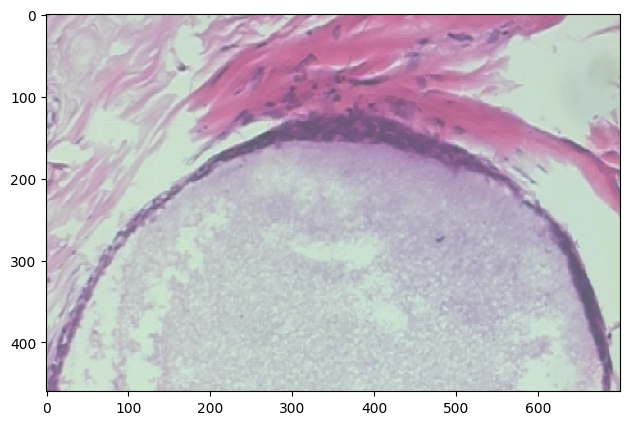

In [118]:
img = io.imread('data-challenge/Train/'+ train_images[10])

### Plot the image
io.imshow(img)

● <b>Flip :</b>

In the context of image augmentation, "flip" refers to the operation of mirroring an image horizontally or vertically.

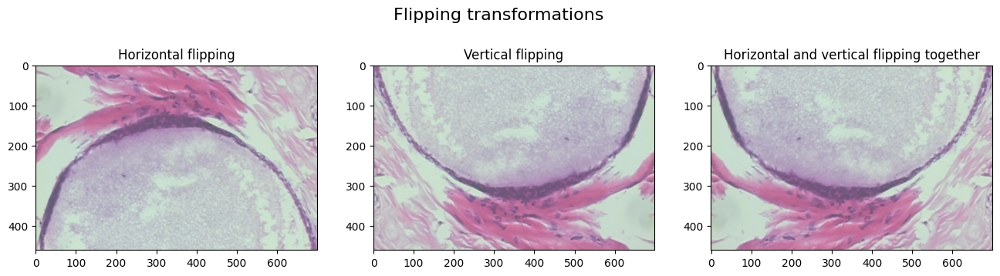

In [119]:
fig, axs = plt.subplots(1, 3, figsize=(16, 6))

fig.suptitle('Flipping transformations', fontsize=16, y=0.82)

ax = axs[0]
ax.set_title('Horizontal flipping')
ax.imshow(cv2.flip(img, 1))

ax = axs[1]
ax.set_title('Vertical flipping')
ax.imshow(cv2.flip(img, 0))

ax = axs[2]
ax.set_title('Horizontal and vertical flipping together')
ax.imshow(cv2.flip(cv2.flip(img, 1), 0))

● <b>Rotate :</b>

In the context of image augmentation, "rotate" refers to the operation of rotating an image by a certain angle around its center.

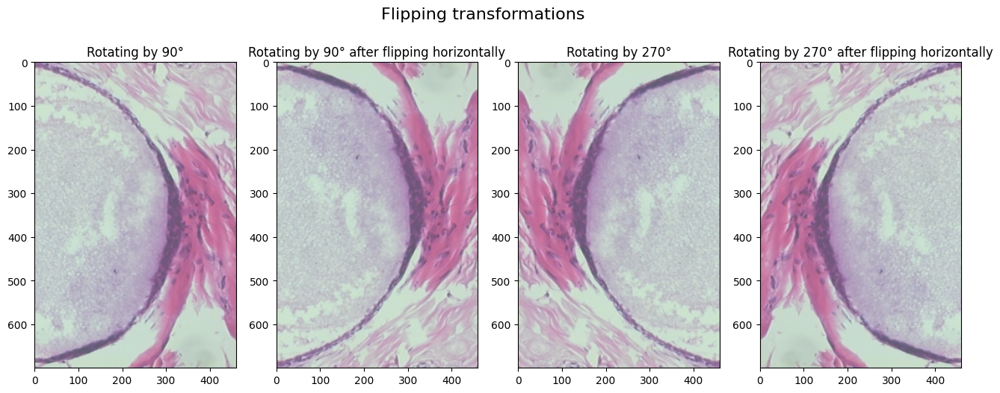

In [120]:
fig, axs = plt.subplots(1, 4, figsize=(16, 6))

fig.suptitle('Flipping transformations', fontsize=16, y=0.96)

ax = axs[0]
ax.set_title('Rotating by 90°')
ax.imshow(cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE))

ax = axs[1]
ax.set_title('Rotating by 90° after flipping horizontally')
ax.imshow(cv2.rotate(cv2.flip(img, 1), cv2.ROTATE_90_CLOCKWISE))

ax = axs[2]
ax.set_title('Rotating by 270°')
ax.imshow(cv2.rotate(cv2.flip(cv2.flip(img, 1), 0), cv2.ROTATE_90_CLOCKWISE))

ax = axs[3]
ax.set_title('Rotating by 270° after flipping horizontally')
ax.imshow(cv2.rotate(cv2.flip(img, 0), cv2.ROTATE_90_CLOCKWISE))

We will try to apply these 7 transformations to each image, and extract the features of the 7 new images :

In [121]:
def func_flip_rotate(image):
    
    img1 = cv2.flip(image, 1)
    img2 = cv2.flip(image, 0)
    img3 = cv2.flip(cv2.flip(image, 1), 0)
    img4 = cv2.rotate(image, cv2.ROTATE_90_CLOCKWISE)
    img5 = cv2.rotate(cv2.flip(image, 1), cv2.ROTATE_90_CLOCKWISE)
    img6 = cv2.rotate(cv2.flip(cv2.flip(image, 1), 0), cv2.ROTATE_90_CLOCKWISE)
    img7 = cv2.rotate(cv2.flip(image, 0), cv2.ROTATE_90_CLOCKWISE)
    
    return [image,img1,img2,img3,img4,img5,img6,img7]

In [122]:
features_hu = []
features_haralick = []
features_histogram = []

for i in train_images:
    image = io.imread('data-challenge/Train/' + i)
    for k in func_flip_rotate(image):
        features_hu.append(fd_hu_moments(k))
        features_haralick.append(fd_haralick(k))
        features_histogram.append(fd_histogram(k))

In [123]:
# The features DataFrame
df_features_flip_rotate = np.hstack([features_haralick, features_hu, features_histogram])
df_features_flip_rotate = pd.DataFrame(df_features_flip_rotate)
df_features_flip_rotate.shape

(3376, 532)

In [124]:
df_features_flip_rotate

,0,1,2,3,4,5,6,7,8,9,...,522,523,524,525,526,527,528,529,530,531
0,0.001627,56.423944,0.957435,662.748202,0.276834,369.391345,2594.568863,7.376357,10.823576,0.000435,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.001627,56.423944,0.957435,662.748202,0.276834,369.391345,2594.568863,7.376357,10.823576,0.000435,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.001627,56.423944,0.957435,662.748202,0.276834,369.391345,2594.568863,7.376357,10.823576,0.000435,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.001627,56.423944,0.957435,662.748202,0.276834,369.391345,2594.568863,7.376357,10.823576,0.000435,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.001627,56.423944,0.957435,662.748202,0.276834,369.391345,2594.568863,7.376357,10.823576,0.000435,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3371,0.000512,102.141569,0.941878,878.742437,0.149443,302.211400,3412.828181,7.508211,11.660066,0.000248,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3372,0.000512,102.141569,0.941878,878.742437,0.149443,302.211400,3412.828181,7.508211,11.660066,0.000248,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3373,0.000512,102.141569,0.941878,878.742437,0.149443,302.211400,3412.828181,7.508211,11.660066,0.000248,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3374,0.000512,102.141569,0.941878,878.742437,0.149443,302.211400,3412.828181,7.508211,11.660066,0.000248,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


We can see that the hu moments, the haralick features and the color histogram features are invariant to rotation and fliping. In fact, we have the same features on all the 8 images (the original image + the 7 images that we got from our transformations).

Let's take the first image as an example. We will compare its features with the features of the 7 images we got from the <i>'flip'</i> and the <i>'rotate'</i> transformations.

In [125]:
df_features_flip_rotate.iloc[:8,:].round(6).nunique().eq(1).all()

True

We used the <b>'iloc[]'</b> to select the first 8 rows and the <b>'round()'</b> method to round the values in the dataframe to 6 decimal places.

The <b>'nunique()'</b> method returns the number of unique values in each column of the dataframe. We then use the <b>'eq(1)'</b> method to check if the number of unique values in each column is equal to 1, which means all values are the same. Finally, we use the <b>'all()'</b> method to check if all the columns satisfy this condition.

We got <i>True</i>, which means that our features are invariant to these transformations. Therefore, we will try other transformations.

● <b>Noise :</b>

Adding noise to an image involves introducing random pixel values into the image.

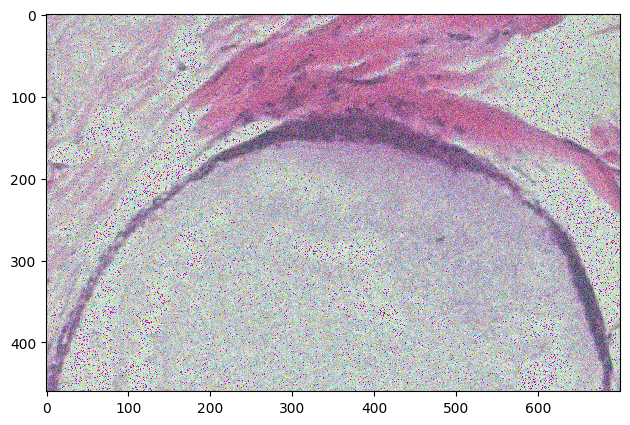

In [126]:
io.imshow((img + np.random.normal(loc=0, scale=25, size=img.shape)).astype(np.uint8))

● <b>Blur :</b>

Bluring an image using a normalized box filter.

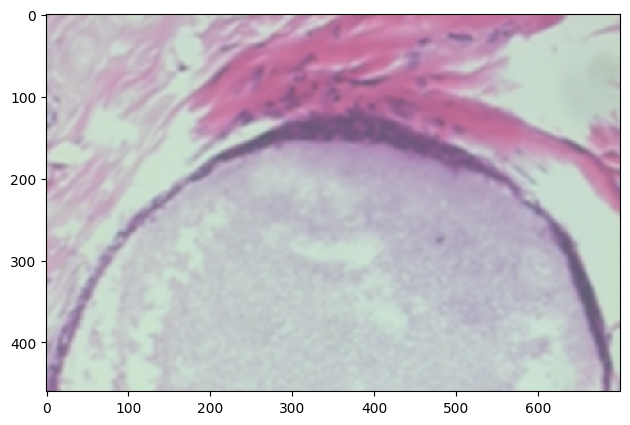

In [127]:
io.imshow(cv2.blur(img, (7, 7)))

● <b>Shearing :</b>

Applying shear transformations to the images to simulate distortions that may occur during tissue preparation or imaging.

In [128]:
def shear(image, shear_range=20):
    height, width, channels = image.shape
    dx = np.random.randint(-shear_range, shear_range + 1)
    dy = np.random.randint(-shear_range, shear_range + 1)

    pts1 = np.float32([[0, 0], [width, 0], [0, height], [width, height]])
    pts2 = np.float32([[0 + dx, 0 + dy], [width + dx, 0 + dy], [0 - dx, height + dy], [width - dx, height + dy]])

    M = cv2.getPerspectiveTransform(pts1, pts2)
    image_sheared = cv2.warpPerspective(image, M, (width, height), borderMode=cv2.BORDER_REFLECT_101)
    return image_sheared

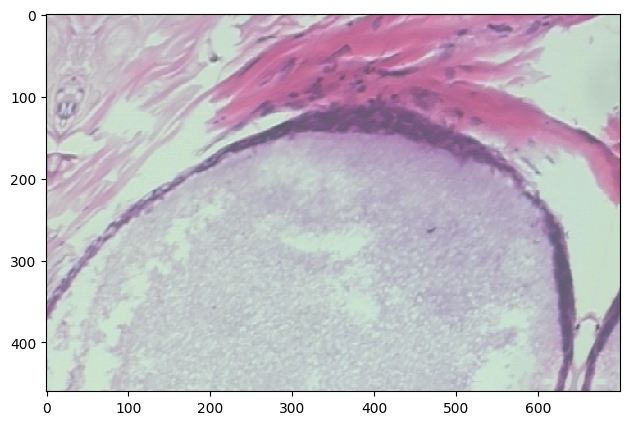

In [129]:
io.imshow(shear(img, shear_range=80))

We will now create a new dataframe with 1688 images instead of 422. In fact, for each image, we will apply 3 transformations : Adding a noise, bluring and shearing.

In [130]:
def func_transformations(image):
    
    img1 = (image + np.random.normal(loc=0, scale=10, size=image.shape)).astype(np.uint8)
    img2 = cv2.blur(image, (10, 10))
    img3 = shear(image, shear_range=40)
    
    return [image,img1,img2,img3]

In [131]:
features_hu = []
features_haralick = []
features_histogram = []

for i in train_images:
    image = io.imread('data-challenge/Train/' + i)
    for k in func_transformations(image):
        features_hu.append(fd_hu_moments(k))
        features_haralick.append(fd_haralick(k))
        features_histogram.append(fd_histogram(k))

In [132]:
# The features DataFrame
df_features_noise_blur_shear = np.hstack([features_haralick, features_hu, features_histogram])
df_features_noise_blur_shear = pd.DataFrame(df_features_noise_blur_shear)
df_features_noise_blur_shear.shape

(1688, 532)

In [133]:
df_features_noise_blur_shear

,0,1,2,3,4,5,6,7,8,9,...,522,523,524,525,526,527,528,529,530,531
0,0.001627,56.423944,0.957435,662.748202,0.276834,369.391345,2594.568863,7.376357,10.823576,0.000435,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000301,150.895192,0.893749,710.071272,0.104681,368.345997,2689.389895,7.576043,12.168497,0.000180,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.004489,6.457766,0.993191,474.171372,0.508203,369.364367,1890.227720,7.164423,9.192476,0.001023,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.001889,53.404267,0.960406,674.347280,0.285998,372.551444,2643.984853,7.334015,10.732501,0.000461,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.001219,56.510977,0.951167,578.571146,0.257090,362.555515,2257.773606,7.336628,10.864025,0.000406,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1683,0.000447,105.325679,0.950260,1058.745997,0.150118,327.278577,4129.658309,7.666134,11.838984,0.000237,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1684,0.000512,102.141569,0.941878,878.742437,0.149443,302.211400,3412.828181,7.508211,11.660066,0.000248,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1685,0.000282,205.831433,0.886455,906.419280,0.090807,300.736652,3419.845687,7.592317,12.387574,0.000148,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1686,0.002637,8.954359,0.992894,630.085545,0.422212,302.120207,2511.387821,7.227713,9.532941,0.000854,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


We can see that these transformations do not preserve the underlying characteristics of the data, and therefore the model may not be able to learn effectively from the augmented data, and the accuracy may decrease.

Let's give an example with the KNN model :

In [134]:
X_train_nbs = apply_pca(df_features_noise_blur_shear, 0.95)
y_train_nbs = y_train.repeat(4).reset_index(drop=True)

In [135]:
smote = SMOTE(random_state=10)
X_train_nbs_smote, y_train_nbs_smote = smote.fit_resample(X_train_nbs, y_train_nbs)

adasyn = ADASYN(random_state=11)
X_train_nbs_adasyn, y_train_nbs_adasyn = adasyn.fit_resample(X_train_nbs, y_train_nbs)

In [136]:
# Define the parameter grid for GridSearchCV
tuned_parameters = [
    {"weights": ["uniform","distance"], "p": [1,2], "n_neighbors": list(range(1,21))}
]

# Create a KNN classifier
knn = KNeighborsClassifier()

# Create a StratifiedKFold object with 4 folds
skf = StratifiedKFold(n_splits=4, shuffle=True)

# Create GridSearchCV objects
grid_search_knn_nbs = GridSearchCV(estimator=knn, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_knn_smote_nbs = GridSearchCV(estimator=knn, param_grid=tuned_parameters, scoring='accuracy', cv=skf)
grid_search_knn_adasyn_nbs = GridSearchCV(estimator=knn, param_grid=tuned_parameters, scoring='accuracy', cv=skf)

# Fit the GridSearchCV object to the train set
grid_search_knn_nbs.fit(X_train_nbs, y_train_nbs)
grid_search_knn_smote_nbs.fit(X_train_nbs_smote, y_train_nbs_smote)
grid_search_knn_adasyn_nbs.fit(X_train_nbs_adasyn, y_train_nbs_adasyn)

print("Best parameters (No over-sampling) : ", grid_search_knn_nbs.best_params_)
print("Best score (No over-sampling) : ", grid_search_knn_nbs.best_score_)

print("\nBest parameters (SMOTE) : ", grid_search_knn_smote_nbs.best_params_)
print("Best score (SMOTE) : ", grid_search_knn_smote_nbs.best_score_)

print("\nBest parameters (ADASYN) : ", grid_search_knn_adasyn_nbs.best_params_)
print("Best score (ADASYN) : ", grid_search_knn_adasyn_nbs.best_score_)

Best parameters (No over-sampling) :  {'n_neighbors': 4, 'p': 2, 'weights': 'distance'}
Best score (No over-sampling) :  0.8607819905213271

Best parameters (SMOTE) :  {'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}
Best score (SMOTE) :  0.9490489130434783

Best parameters (ADASYN) :  {'n_neighbors': 1, 'p': 2, 'weights': 'uniform'}
Best score (ADASYN) :  0.9612039960197295


In [137]:
# Without Data Augmentation
print(tabulate([['No over-sampling', grid_search_knn.best_score_],
                ['SMOTE', grid_search_knn_smote.best_score_],
                ['ADASYN', grid_search_knn_adasyn.best_score_]],
               headers=["Over-sampling technique","Score"]))

Over-sampling technique       Score
-------------------------  --------
No over-sampling           0.796181
SMOTE                      0.922554
ADASYN                     0.937845


In [138]:
# With Data Augmentation
print(tabulate([['No over-sampling', grid_search_knn_nbs.best_score_],
                ['SMOTE', grid_search_knn_smote_nbs.best_score_],
                ['ADASYN', grid_search_knn_adasyn_nbs.best_score_]],
               headers=["Over-sampling technique","Score"]))

Over-sampling technique       Score
-------------------------  --------
No over-sampling           0.860782
SMOTE                      0.949049
ADASYN                     0.961204


As you can see, the KNN model gave better results after applying the data augmentation. But, remember that, after applying these 3 transformations to our train set, the distributions of the train set and the test set became very different. So, when we tried the KNN implementation with ADASYN and data augmentation, it gave us a lower accuracy on the test set than the one we obtained when we performed the KNN and ADASYN without data augmentation.

Consequently, we decided to not take data augmentation into consideration.

### Things that might be useful :

We can add some other useful features to our dataframe. Adding features can be very efficient in the context of a computer vision classification problem. There are many known features, but we will introduce only two, which are very used nowadays in computer vision :

➣ <i>Local binary patterns (LBP)</i>
<br>➣ <i>Histogram of Oriented gradients (HOG)</i>

In [139]:
img = io.imread('data-challenge/Train/'+ train_images[0])

###### Local Binary Patterns :

LBP is a texture descriptor used for the property of high discrimination power. LBP labels each pixel in an image by comparing the gray level with the neighboring pixels and then assigning a binary number.

Unlike Haralick texture features that compute a global representation of texture based on the Gray Level Co-occurrence Matrix, LBPs instead compute a local representation of texture. This local representation is constructed by comparing each pixel with its surrounding neighborhood of pixels.

● The first step in constructing the LBP texture descriptor is to convert the image to grayscale.

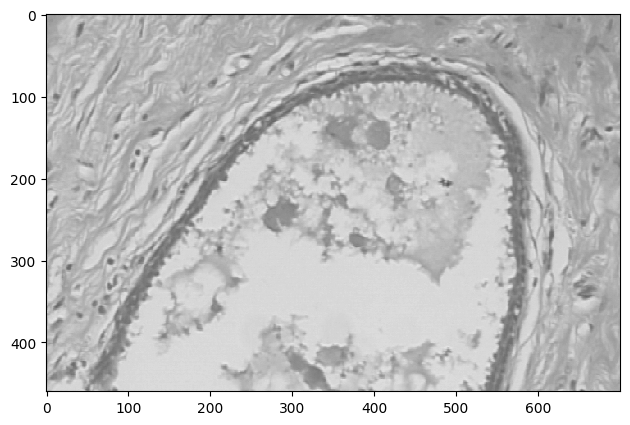

In [140]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

io.imshow(gray)

● For each pixel in the grayscale image, we select a neighborhood of size r (we will choose r=8) surrounding the center pixel.

In [141]:
pd.DataFrame(gray[:3,:3])

,0,1,2
0,194,187,182
1,189,183,176
2,185,180,174


In this example, we took the top-left 3x3 window of our gray image. The center pixel here is equal to 183.

● We take the center pixel (highlighted in red) and threshold it against its neighborhood of 8 pixels. If the intensity of the center pixel is greater-than-or-equal to its neighbor, then we set the value to 1; otherwise, we set it to 0.

In [142]:
pd.DataFrame((gray[:3,:3] >= 183).astype(int))

,0,1,2
0,1,1,0
1,1,1,0
2,1,0,0


● Starting from the bottom-right pixel clockwise, we get a binary number, which is 00111100, which is equal to 60.

In [143]:
local_binary_pattern(gray, 8, 1, 'default')

array([[  0.,  48.,  48., ..., 225., 225.,  64.],
       [  4.,  60.,  62., ..., 241., 227.,  68.],
       [  4.,  28.,  60., ..., 193., 195.,  64.],
       ...,
       [195., 227.,  39., ...,  96., 255.,  68.],
       [  3.,   0.,  30., ...,  52., 187.,   4.],
       [  6.,  30.,  30., ...,  28.,  31.,   4.]])

This function calculates the binary number for every pixel in our gray image. We can see that in the (1,1) position we have 60, and that's the same position of our center pixel 183 in the gray image.

● Compute the histogram, over the cell, of the frequency of each "number" occurring (i.e., each combination of which pixels are smaller and which are greater than the center). This histogram can be seen as a 256-dimensional feature vector.

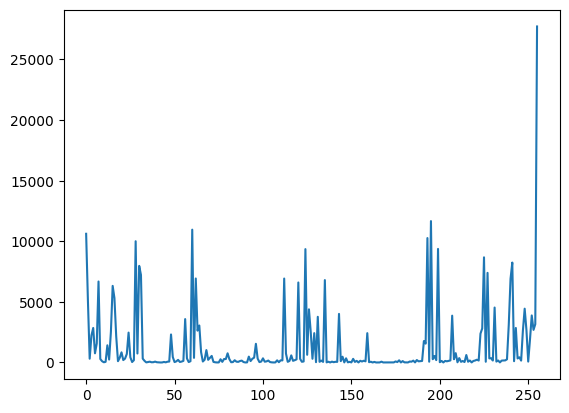

In [144]:
lbp = local_binary_pattern(gray, 8, 1, 'default')

plt.plot(cv2.calcHist([lbp.astype('float32')], [0], None, [256], [0, 256]))

We can change the number of bins to be equal to 16 :

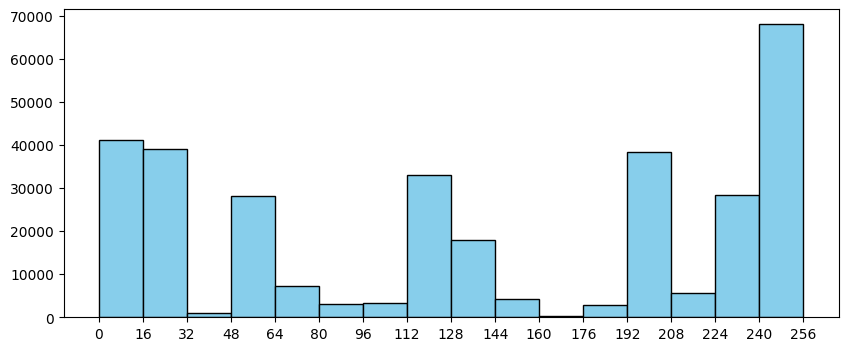

In [145]:
fig, ax = plt.subplots(1, 1, figsize=(10,4))

ax.bar(x=np.linspace(0,256,17)[:-1],
       height=cv2.calcHist([lbp.astype('float32')], [0], None, [16], [0, 256]).flatten(),
       width=np.diff(np.linspace(0,256,17)),
       align='edge',
       fc='skyblue',
       ec='black')

ax.set_xticks(np.linspace(0,256,17))

plt.show()

● We normalize this histogram. We divide each element by the euclidean norm of the array (the L2 norm), which is the root of the sum of the squares of the elements in the array.

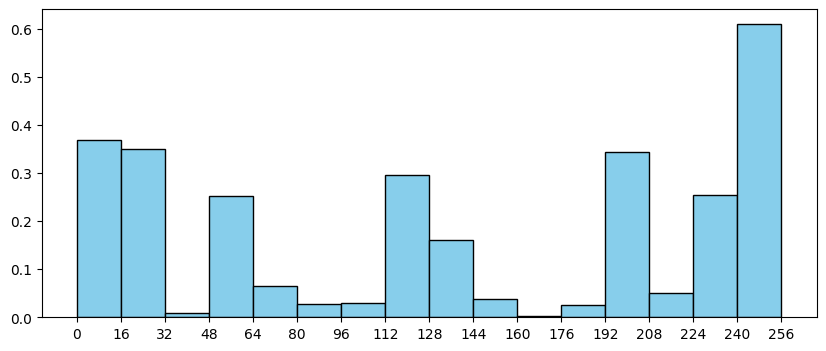

In [146]:
hist = cv2.calcHist([lbp.astype('float32')], [0], None, [16], [0, 256])

hist = cv2.normalize(hist, hist)

fig, ax = plt.subplots(1, 1, figsize=(10,4))

ax.bar(x=np.linspace(0,256,17)[:-1],
       height=hist.flatten(),
       width=np.diff(np.linspace(0,256,17)),
       align='edge',
       fc='skyblue',
       ec='black')

ax.set_xticks(np.linspace(0,256,17))

plt.show()

● We flatten our histogram array.

In [147]:
hist.flatten()

array([0.36769378, 0.3497896 , 0.00808865, 0.2532089 , 0.06554137,
       0.02693236, 0.02881136, 0.29492274, 0.15978673, 0.03902955,
       0.00289008, 0.02644918, 0.3441347 , 0.04948038, 0.25438997,
       0.6099866 ], dtype=float32)

In [148]:
# Given a BGR image, this function returns the LBP features

### Step 1 : We convert the BGR image to Gray image
### Step 2 : We calculate the LBP features
### Step 3 : We calculate an histogram features using calcHist (the output is a (bins,1) matrix)
### Step 4 : We normalize and flatten this histogram array


def fd_lbp(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    lbp = local_binary_pattern(gray, 8, 1, 'default')
    hist  = cv2.calcHist([lbp.astype('float32')], [0], None, [16], [0, 256])
    cv2.normalize(hist, hist)
    return hist.flatten()

###### Histogram of Oriented Gradients :

HOG, or Histogram of Oriented Gradients, is a feature descriptor that is often used to extract features from image data. It is widely used in computer vision tasks for object detection. The technique counts occurrences of gradient orientation in localized portions of an image. The essential thought behind the histogram of oriented gradients descriptor is that local object appearance and shape within an image can be described by the distribution of intensity gradients or edge directions. The image is divided into small connected regions called cells, and for the pixels within each cell, a histogram of gradient directions is compiled. The descriptor is the concatenation of these histograms.

<img src="https://scikit-image.org/docs/dev/_images/sphx_glr_plot_hog_001.png" />

● The first step in constructing the HOG feature descriptor is to bring down the width to height ratio to 2:1. The image size should preferably be $256\times512$ or $128\times256$. This is because we will be dividing the image into $8\times8$ and $16\times16$ patches to extract the features.

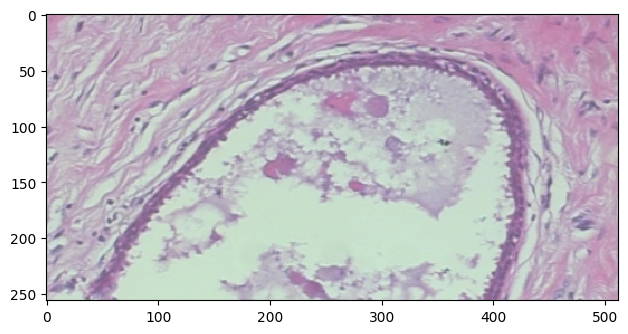

In [149]:
resized_img = resize(img, (256, 512))

io.imshow(resized_img)

● The next step is to calculate the gradient for every pixel in the image. Gradients are the small change in the x and y directions.

Let's say that we have the below pixel matrix :

<img src="https://cdn.analyticsvidhya.com/wp-content/uploads/2019/08/article-image-3.png" />

Now, to determine the gradient (or change) in the x-direction, we need to subtract the value on the left from the pixel value on the right. Similarly, to calculate the gradient in the y-direction, we will subtract the pixel value below from the pixel value above the selected pixel.

Change in X direction ($G_x$) = 89 – 78 = 11
<br>Change in Y direction ($G_y$) = 68 – 56 = 8

● Using the gradients we calculated in the last step, we will now determine the magnitude and direction for each pixel value. For this step, we will be using the Pythagoras theorem :

<img src="https://cdn.analyticsvidhya.com/wp-content/uploads/2019/08/Article-image-4.png" />

Total Gradient Magnitude =  $\sqrt{{G_x}^2 + {G_y}^2}$ = $\sqrt{{11}^2 + {8}^2}$ = $13.6$

Next, to calculate the orientation (or direction) for the same pixel, we know that : $tan~(Φ) = \frac{G_y}{G_x}$

Therefore : $Φ = arctan~(\frac{G_y}{G_x})$ = $36°$

● A histogram is a plot that shows the frequency distribution of a set of continuous data. We have the variable (in the form of bins) on the x-axis and the frequency on the y-axis. Let's choose the number of orientations to be equal to 9. The number of orientations is the number of bins in the histogram.

<img src="https://cdn.analyticsvidhya.com/wp-content/uploads/2019/08/article-image-13.png" />

We took into consideration the second and third bins because 20 < 36 < 40.

This is done pixel by pixel, and at each step we update this frequency table.

● Calculate Histogram of Gradients in $8\times8$ cells :

The histograms created in the HOG feature descriptor are not generated for the whole image. Instead, the image is divided into 8×8 cells, and the histogram of oriented gradients is computed for each cell. By doing so, we get the features (or histogram) for the smaller patches which in turn represent the whole image. We can certainly change this value here from $8\times8$ to $16\times16$ or $32\times32$.

If we divide the image into $8\times8$ cells and generate the histograms, we will get a $9\times1$ matrix for each cell.

● Finally, we normalize the gradients using blocks :
    
Before we understand how this is done, it’s important to understand why this is done in the first place.

Although we already have the HOG features created for the $8\times8$ cells of the image, the gradients of the image are sensitive to the overall lighting. This means that for a particular picture, some portion of the image would be very bright as compared to the other portions.

We cannot completely eliminate this from the image. But we can reduce this lighting variation by normalizing the gradients by taking $16\times16$ blocks. Here is an example that can explain how $16\times16$ blocks are created :

<img src="https://cdn.analyticsvidhya.com/wp-content/uploads/2019/08/article-image-7.png" />

That means that we have $(2,2)$ cells per block.

Here, we will be combining four $8\times8$ cells to create a $16\times16$ block. And we already know that each $8\times8$ cell has a $9\times1$ matrix for a histogram. So, we would have four $9\times1$ matrices or a single $36\times1$ matrix. To normalize this matrix, we will divide each of these values by the square root of the sum of squares of the values.

● Features for the whole image :

The resized image is of shape $(256,512)$. Therefore, we would have $1953$ $(31\times63)$ blocks of $16\times16$. Each of these $1953$ blocks has a vector of $36\times1$ as features. Hence, the total features for the image would be $1953\times36\times1 = 70308$ features.

In [150]:
fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(8, 8), 
                    cells_per_block=(2, 2), visualize=True, channel_axis=-1)

In [151]:
print("The total number of features is :", len(fd))

The total number of features is : 70308


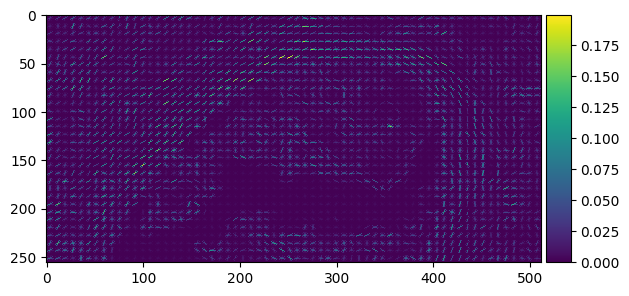

In [156]:
# Plot the feature matrix
io.imshow(hog_image)

### Conclusion :

This project was very informative. We became familiar with the different feature extraction techniques that are used in computer vision (Hu moments, Haralick features, Color histogram in HSV, Local Binary Pattern features, Histogram of Oriented Gradients). We also implemented PCA for dimensionality reduction. Besides, we implemented SMOTE and ADASYN algorithms in order to deal with imbalanced data. Furthermore, we implemented GridSearchCV along with multiple classification algorithms, and we also managed to implement a neural network with three hidden layers. Finally, we became familiar with several data augmentation methods (fliping, rotating, adding noise, bluring, shearing) even though data augmentation didn't work for us.

Finally, I would like to thank the educational team for this project that was more than instructive.